In [ ]:

# ===== Fragment 0: Imports, globals, helpers =====
from pathlib import Path
import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
# Global matplotlib parameters (without specifying specific colors)
mpl.rcParams.update({
    "font.family": "serif",
    "font.serif": ["Times New Roman", "Times", "DejaVu Serif"],
    "font.size": 16,
    "axes.titlesize": 16,
    "axes.labelsize": 14,
    "xtick.labelsize": 16,
    "ytick.labelsize": 16,
    "legend.fontsize": 16,
    "figure.dpi": 350,
    "savefig.dpi": 350,
    "savefig.bbox": "tight",
    "axes.grid": True,
    "grid.alpha": 0.25,
    "lines.linewidth": 1.6,
    "axes.spines.top": False,
    "axes.spines.right": False,
})

np.random.seed(42)
pd.set_option("display.max_rows", 200)
pd.set_option("display.max_columns", 200)

# ---------- helpers ----------
def add_value_labels(ax, fmt="{:.3g}", vpad=0.01):
    """Подписи над столбцами bar-chart."""
    ymin, ymax = ax.get_ylim()
    vrange = ymax - ymin if ymax > ymin else 1.0
    for rect in ax.patches:
        h = rect.get_height()
        if np.isfinite(h):
            x = rect.get_x() + rect.get_width() / 2.0
            y = h + vpad * vrange
            ax.text(x, y, fmt.format(h), ha="center", va="bottom")

def show_hist(series: pd.Series, title: str, xlabel: str, bins: int = 60,
              figsize=(7, 3), dpi=350):
    """Гистограмма без сохранения — только show()."""
    s = pd.to_numeric(series, errors="coerce").dropna()
    if s.empty:
        return
    fig = plt.figure(figsize=figsize, dpi=dpi)
    plt.hist(s, bins=bins)
    plt.title(title)
    plt.xlabel(xlabel)
    plt.ylabel("Count")
    plt.tight_layout()
    plt.show()

def heatmap_with_ann(mat: np.ndarray, xlabels, ylabels, title: str,
                     figsize=(10, 8), dpi=350, fmt="{:.2f}"):
    """Матрица с подписями значений внутри ячеек."""
    fig = plt.figure(figsize=figsize, dpi=dpi)
    ax = plt.gca()
    im = ax.imshow(mat, aspect="auto")
    plt.colorbar(im)
    ax.set_xticks(range(len(xlabels)))
    ax.set_xticklabels(list(xlabels), rotation=45, ha="right")
    ax.set_yticks(range(len(ylabels)))
    ax.set_yticklabels(list(ylabels))
    ax.set_title(title)
    ax.grid(False)

    # Annotations with adaptive font color
    nrows, ncols = mat.shape
    norm = plt.Normalize(vmin=np.nanmin(mat), vmax=np.nanmax(mat))
    cmap = im.get_cmap()
    for i in range(nrows):
        for j in range(ncols):
            v = mat[i, j]
            if np.isfinite(v):
                rgba = cmap(norm(v))
                luminance = 0.299*rgba[0] + 0.587*rgba[1] + 0.114*rgba[2]
                ax.text(j, i, fmt.format(v),
                        ha="center", va="center",
                        color=("black" if luminance > 0.5 else "white"))
    plt.tight_layout()
    plt.show()


In [ ]:
# ===== Fragment 1: Load dataset =====
CANDIDATES = [
    "original_dataset_china/renewables_combined_FULL.csv",
    "original_dataset_china/renewables_combined_CLEAN.csv",

]
DATA_PATH = None
for p in CANDIDATES:
    try:
        _df = pd.read_csv(p, low_memory=False)
        DATA_PATH = p
        break
    except Exception:
        continue


df = _df.copy()
print("Loaded:", DATA_PATH)
print("Shape:", df.shape)
print("Columns:", list(df.columns)[:20], "...")

# Time: parsing timestamp (naively, without forcing UTC)
df["timestamp"] = pd.to_datetime(df.get("timestamp"), errors="coerce")
df["year"]  = df["timestamp"].dt.year
df["month"] = df["timestamp"].dt.month
df["day"]   = df["timestamp"].dt.day
df["hour"]  = df["timestamp"].dt.hour
df["doy"]   = df["timestamp"].dt.dayofyear
df["week"]  = df["timestamp"].dt.isocalendar().week.astype('Int64')

# Season, if not present
if "season_derived" not in df.columns:
    def _season(m: int) -> str:
        if m in (12, 1, 2):  return "winter"
        if m in (3, 4, 5):   return "spring"
        if m in (6, 7, 8):   return "summer"
        return "autumn"
    df["season_derived"] = df["month"].map(_season)

print("Time range:", df["timestamp"].min(), "→", df["timestamp"].max())


Loaded: original_dataset_china/renewables_combined_FULL.csv
Shape: (8753, 18)
Columns: ['datetime_solar', 'hour_index_solar', 'temperature_solar', 'humidity_solar', 'surface_irradiance_solar', 'toa_irradiance_solar', 'kWh_solar_power_solar', 'sheet_solar', 'timestamp', 'specific_humidity_solar', 'relative_humidity_solar', 'datetime_wind', 'hour_index_wind', 'air_density_wind', 'wind_speed_wind', 'kWh_wind_power_wind', 'sheet_wind', 'season_derived'] ...
Time range: 2019-01-01 08:00:00 → 2019-12-31 23:00:00


In [ ]:
# ===== Fragment 2: Identify targets & features =====
cols = df.columns.tolist()

def find_power_target(suffix: str):
    # 1) kWt_* priority
    cands = [c for c in cols if c.endswith(suffix) and c.lower().startswith("kwt_")]
    if cands:
        return cands[0]
    # 2) without kWt_
    cands = [c for c in cols if c.endswith(suffix) and ("power" in c.lower())]
    return cands[0] if cands else None

solar_target = find_power_target("_solar")
wind_target  = find_power_target("_wind")

#  Feature lists (robust)
solar_feature_keys = ["irradiance_solar", "surface_irradiance_solar", "toa_irradiance_solar",
                      "temperature_solar", "module_temperature_solar", "humidity_solar",
                      "relative_humidity_solar", "specific_humidity_solar"]
wind_feature_keys  = ["wind_speed_wind", "wind_direction_wind", "air_density_wind"]

solar_feats = [c for c in cols if any(k == c for k in solar_feature_keys)]
wind_feats  = [c for c in cols if any(k == c for k in wind_feature_keys)]

print("Solar target:", solar_target)
print("Wind  target:", wind_target)
print("Solar features:", solar_feats)
print("Wind  features:", wind_feats)


Solar target: kWh_solar_power_solar
Wind  target: kWh_wind_power_wind
Solar features: ['temperature_solar', 'humidity_solar', 'surface_irradiance_solar', 'toa_irradiance_solar', 'specific_humidity_solar', 'relative_humidity_solar']
Wind  features: ['air_density_wind', 'wind_speed_wind']


In [ ]:
# ===== Fragment 3: Basic overview =====
print("Rows, Cols:", df.shape)
print("Time coverage:", df["timestamp"].min(), "→", df["timestamp"].max())
print("Season distribution:", df["season_derived"].value_counts(dropna=False).to_dict())

# Duplicate timestamps
if "timestamp" in df.columns:
    dup_count = int(df["timestamp"].duplicated().sum())
    print("Duplicate timestamp rows:", dup_count)

# Top-20 missing values
missing = (
    df.isna().sum().sort_values(ascending=False)
      .to_frame("missing_count")
      .assign(missing_pct=lambda s: (s["missing_count"] / df.shape[0] * 100).round(3))
)
print(missing.head(20))

# Numeric statistics (top-20 rows)
desc = df.select_dtypes(include=[np.number]).describe().T
print(desc.head(20))

# First five rows for visual inspection
print(df.head(5))


Rows, Cols: (8753, 24)
Time coverage: 2019-01-01 08:00:00 → 2019-12-31 23:00:00
Season distribution: {'spring': 2209, 'summer': 2208, 'autumn': 2184, 'winter': 2152}
Duplicate timestamp rows: 1
                         missing_count  missing_pct
datetime_solar                       0          0.0
hour_index_solar                     0          0.0
doy                                  0          0.0
hour                                 0          0.0
day                                  0          0.0
month                                0          0.0
year                                 0          0.0
season_derived                       0          0.0
sheet_wind                           0          0.0
kWh_wind_power_wind                  0          0.0
wind_speed_wind                      0          0.0
air_density_wind                     0          0.0
hour_index_wind                      0          0.0
datetime_wind                        0          0.0
relative_humidity_solar   

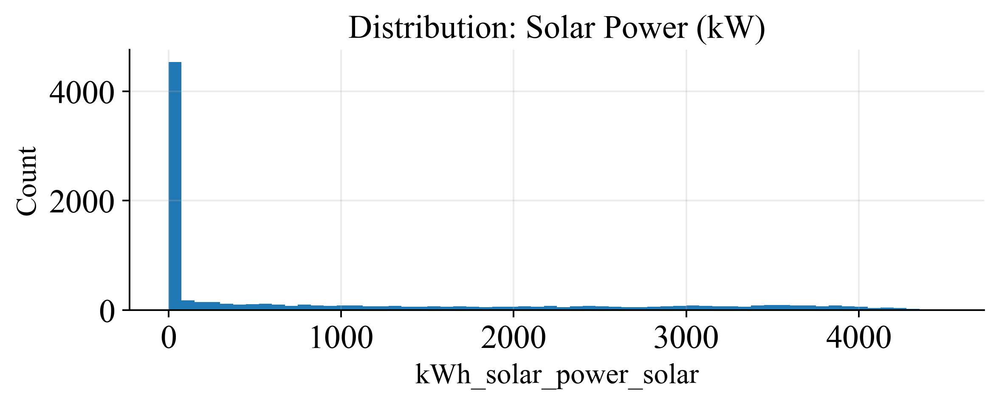

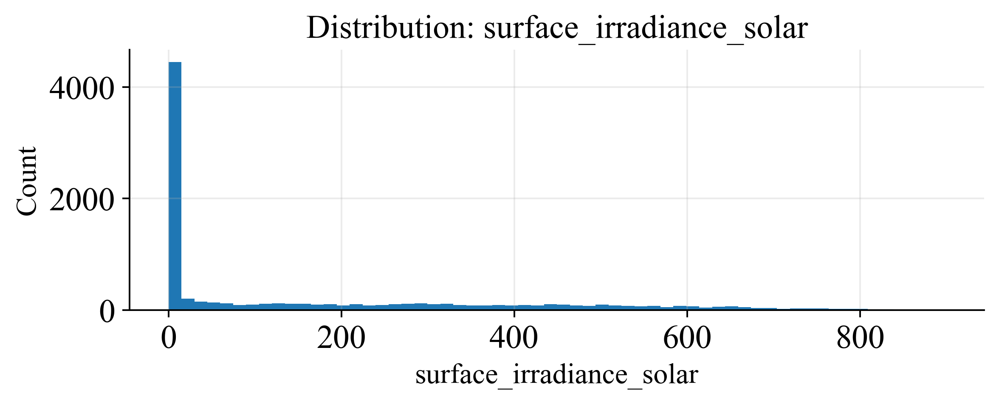

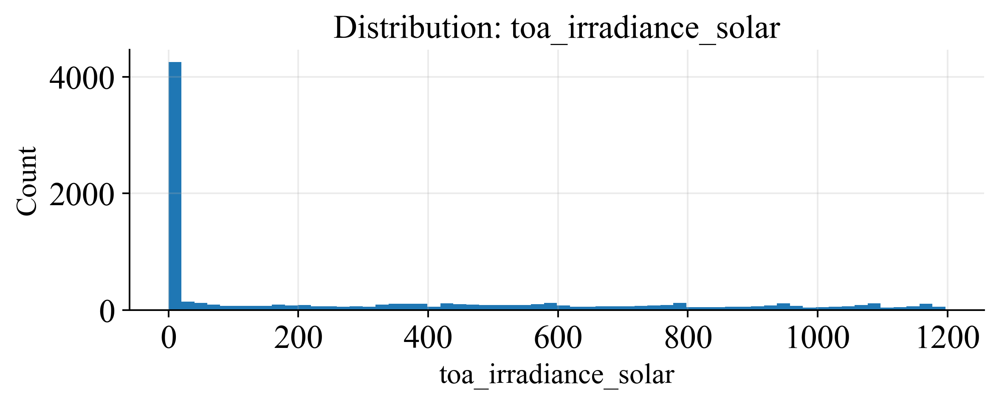

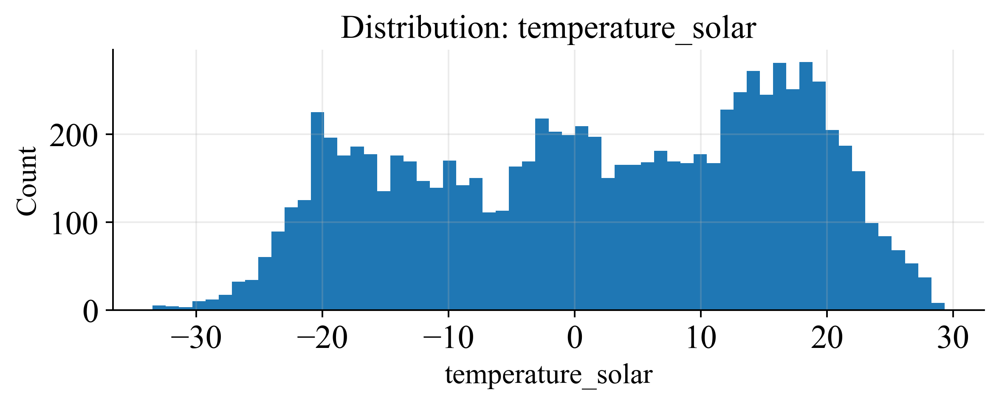

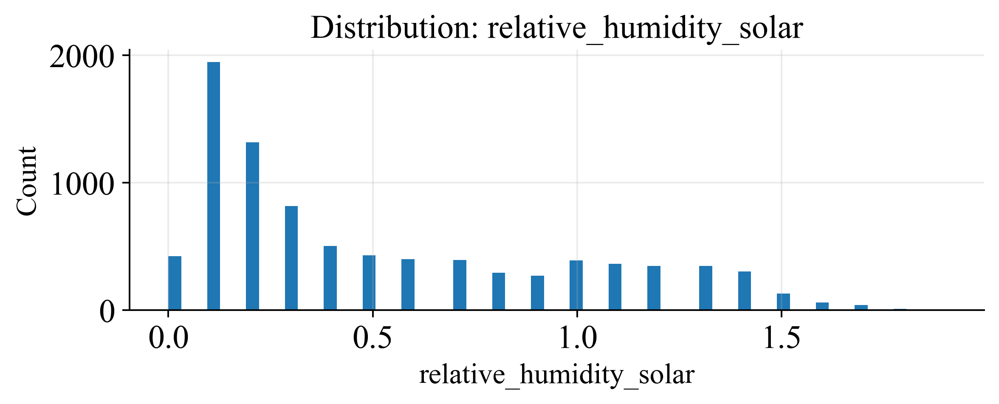

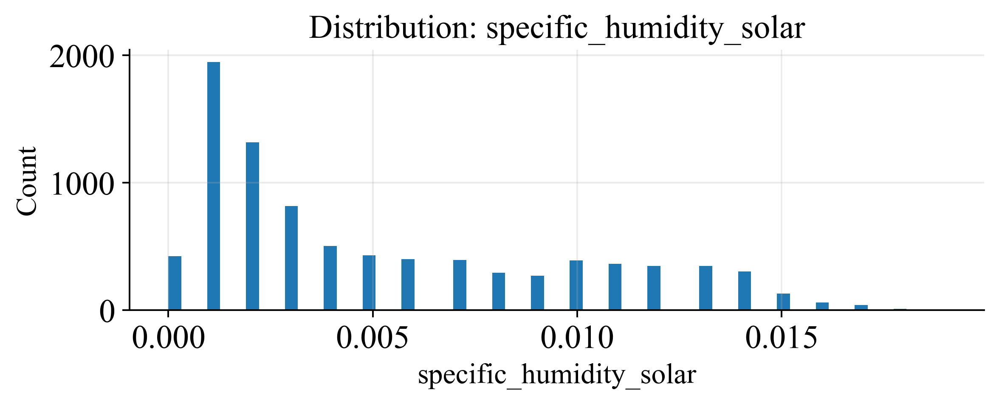

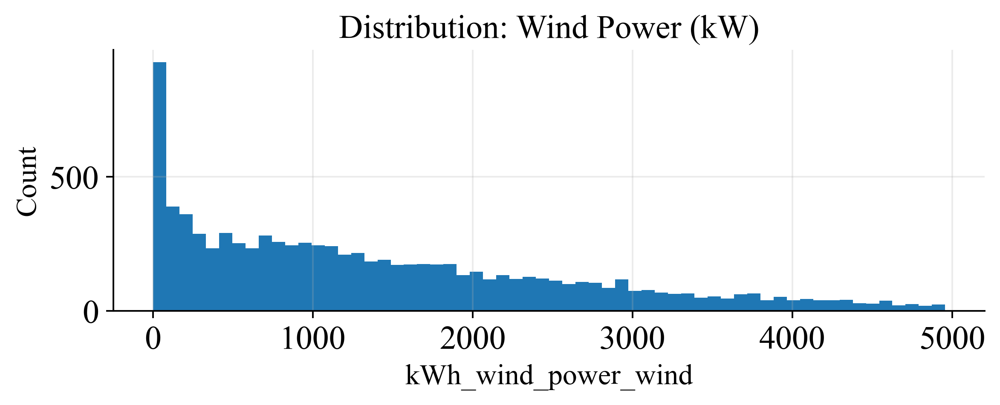

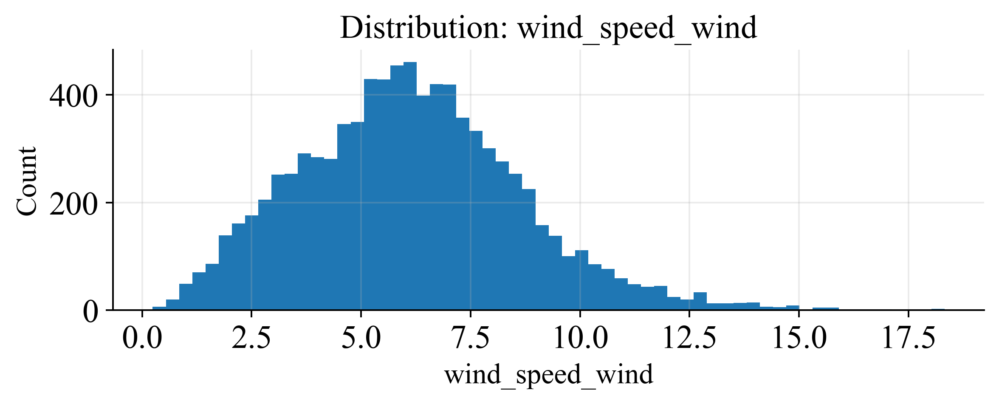

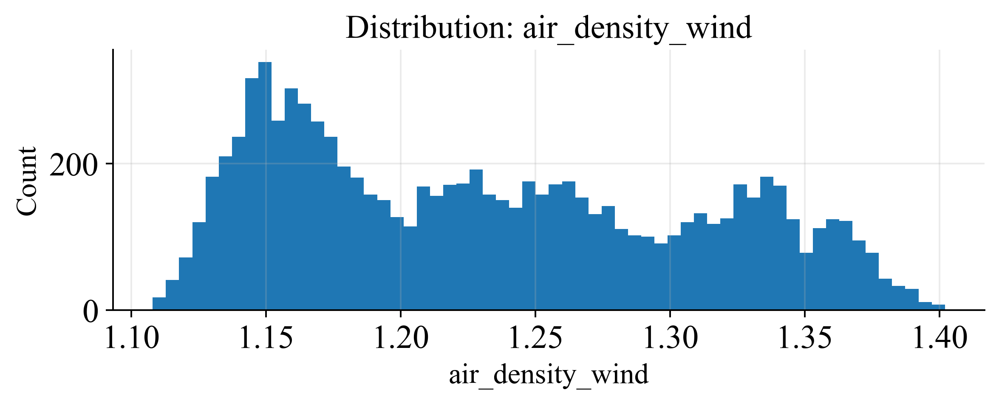

In [34]:
# ===== Fragment 5: Distributions =====
# Solar
if solar_target and solar_target in df.columns:
    show_hist(df[solar_target], "Distribution: Solar Power (kW)", solar_target)
for c in ["surface_irradiance_solar", "toa_irradiance_solar", "irradiance_solar",
          "temperature_solar", "module_temperature_solar",
          "relative_humidity_solar", "specific_humidity_solar"]:
    if c in df.columns:
        show_hist(df[c], f"Distribution: {c}", c)

# Wind
if wind_target and wind_target in df.columns:
    show_hist(df[wind_target], "Distribution: Wind Power (kW)", wind_target)
for c in ["wind_speed_wind", "wind_direction_wind", "air_density_wind"]:
    if c in df.columns:
        show_hist(df[c], f"Distribution: {c}", c)


Dropped from correlation matrix (reason: non-informative or explicit):
['year']


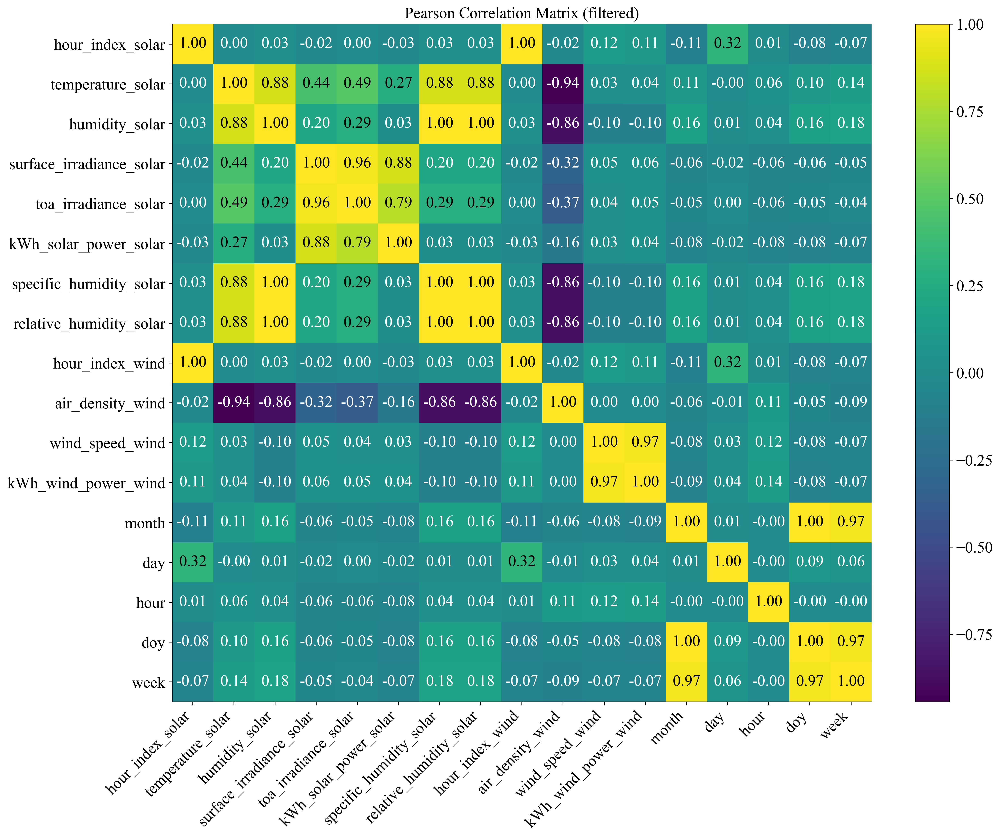

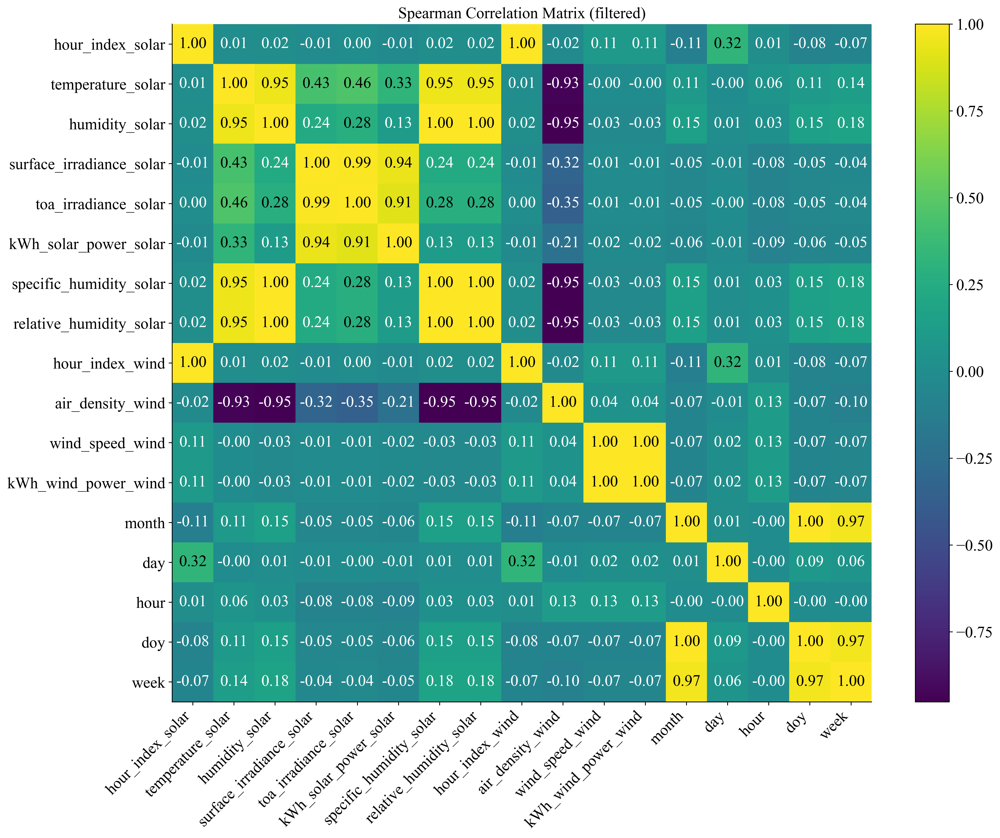

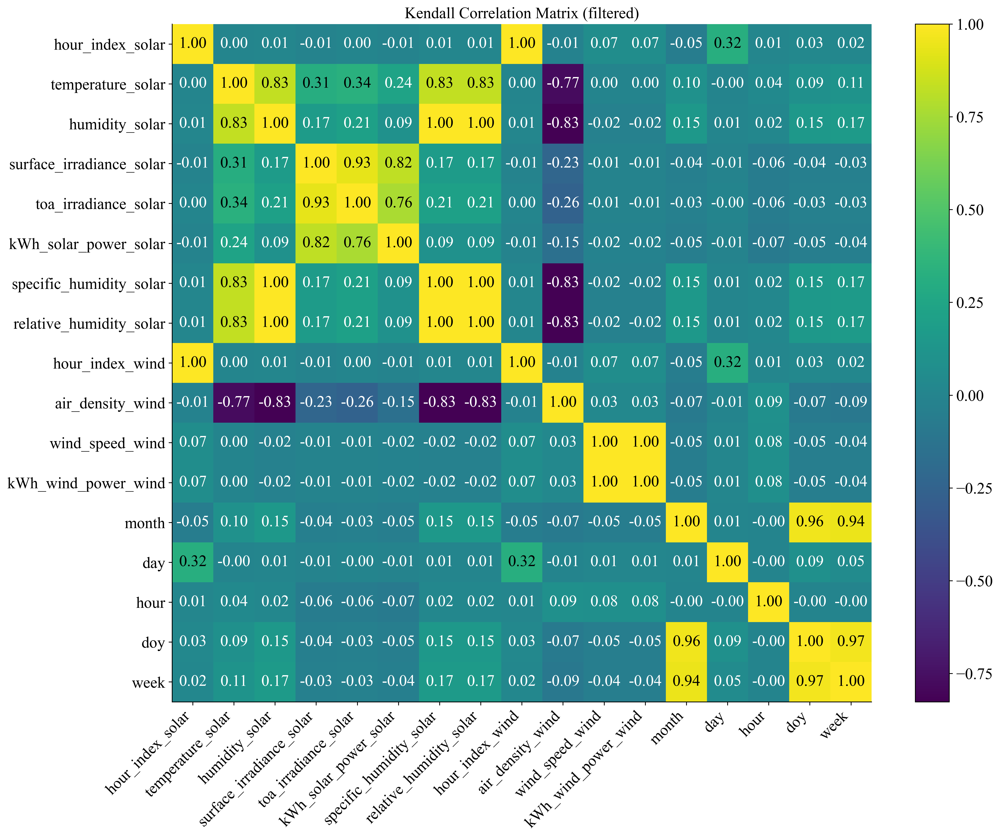


Top 10 pearson correlations with kWh_solar_power_solar:
surface_irradiance_solar    0.877205
toa_irradiance_solar        0.789576
temperature_solar           0.266562
kWh_wind_power_wind         0.044851
wind_speed_wind             0.031430
relative_humidity_solar     0.026410
humidity_solar              0.026410
specific_humidity_solar     0.026410
day                        -0.024913
hour_index_solar           -0.025681
Name: kWh_solar_power_solar, dtype: float64

Bottom 10 pearson correlations with kWh_solar_power_solar:
humidity_solar             0.026410
specific_humidity_solar    0.026410
day                       -0.024913
hour_index_solar          -0.025681
hour_index_wind           -0.025681
week                      -0.073382
hour                      -0.075558
month                     -0.078084
doy                       -0.080253
air_density_wind          -0.157554
Name: kWh_solar_power_solar, dtype: float64

Top 10 spearman correlations with kWh_solar_power_solar:
surface

In [ ]:

# --------   filtering out non-informative numeric columns --------
num_df = df.select_dtypes(include=[np.number]).copy()

drop_explicit = {"year"}  # since we have only one year — year is non-informative
# (if desired, add 'week', 'day', etc. here)

# auto-drop: constant/almost constant
near_const = set()
for c in num_df.columns:
    s = num_df[c].dropna()
    if s.nunique(dropna=True) <= 1:
        near_const.add(c)
    else:
        # zero variance — definitely no signal
        if np.isclose(s.std(ddof=0), 0.0, atol=1e-12):
            near_const.add(c)

to_drop = (drop_explicit | near_const) & set(num_df.columns)
num_df_f = num_df.drop(columns=list(to_drop), errors="ignore")

print("Dropped from correlation matrix (reason: non-informative or explicit):")
print(sorted(list(to_drop)))

labels = num_df_f.columns.tolist()

if len(labels) >= 2:
    # Pearson
    C_p = num_df_f.corr(method="pearson").values
    heatmap_with_ann(C_p, labels, labels, "Pearson Correlation Matrix (filtered)",
                     figsize=(15, 12), dpi=350, fmt="{:.2f}")

    # Spearman
    C_s = num_df_f.corr(method="spearman").values
    heatmap_with_ann(C_s, labels, labels, "Spearman Correlation Matrix (filtered)",
                    figsize=(15, 12), dpi=350, fmt="{:.2f}")

    # Kendall
    C_k = num_df_f.corr(method="kendall").values
    heatmap_with_ann(C_k, labels, labels, "Kendall Correlation Matrix (filtered)",
                    figsize=(15, 12), dpi=350, fmt="{:.2f}")

# Top correlations with targets (filtered dataset)
def top_corr_with_target(target, k=10, method="pearson"):
    if (target is None) or (target not in num_df_f.columns):
        return
    corr = num_df_f.corr(method=method)[target].drop(target).sort_values(ascending=False)
    print(f"\nTop {k} {method} correlations with {target}:")
    print(corr.head(k))
    print(f"\nBottom {k} {method} correlations with {target}:")
    print(corr.tail(k))

top_corr_with_target(solar_target, 10, "pearson")
top_corr_with_target(solar_target, 10, "spearman")
top_corr_with_target(wind_target,  10, "pearson")
top_corr_with_target(wind_target,  10, "spearman")

In [ ]:
# --- helpers required by dual plots ---
# ensure that hour and month are present
if "timestamp" in df.columns:
    if "hour" not in df.columns:
        df["hour"] = pd.to_datetime(df["timestamp"], errors="coerce").dt.hour
    if "month" not in df.columns:
        df["month"] = pd.to_datetime(df["timestamp"], errors="coerce").dt.month

def _hourly_means(series: pd.Series):
    s = pd.to_numeric(series, errors="coerce")
    tmp = pd.DataFrame({"val": s, "hour": df["hour"]}).dropna()
    if tmp.empty:
        return None
    return tmp.groupby("hour")["val"].mean()

def _monthly_means(series: pd.Series):
    s = pd.to_numeric(series, errors="coerce")
    tmp = pd.DataFrame({"val": s, "month": df["month"]}).dropna()
    if tmp.empty:
        return None
    # reindex to 1..12 for a complete axis
    return tmp.groupby("month")["val"].mean().reindex(range(1, 13))


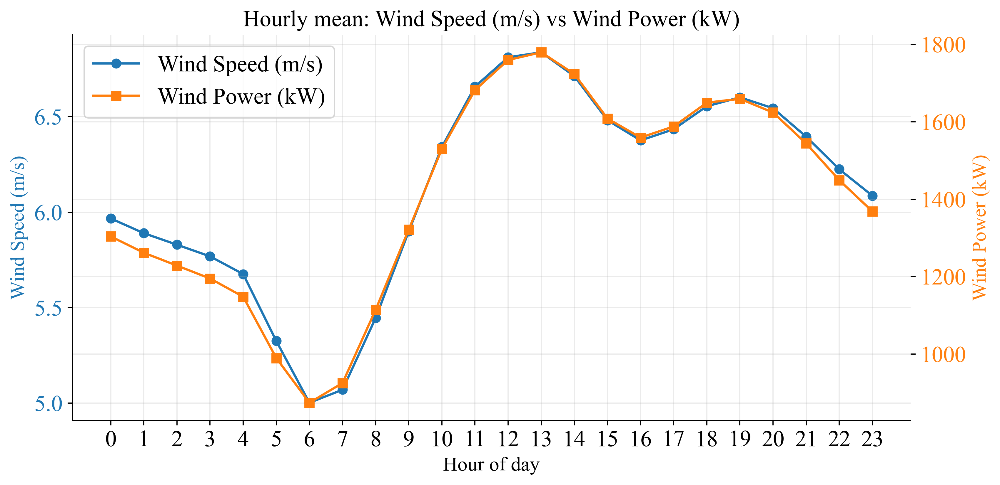

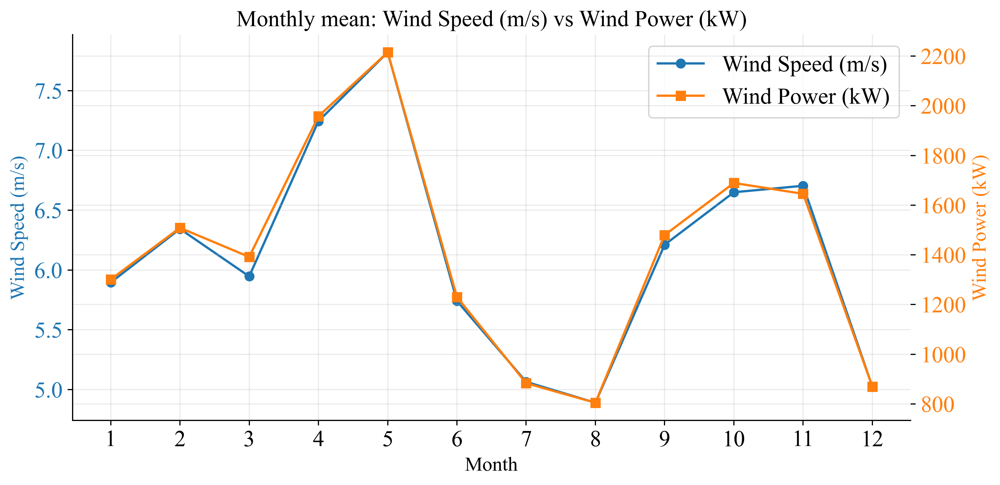

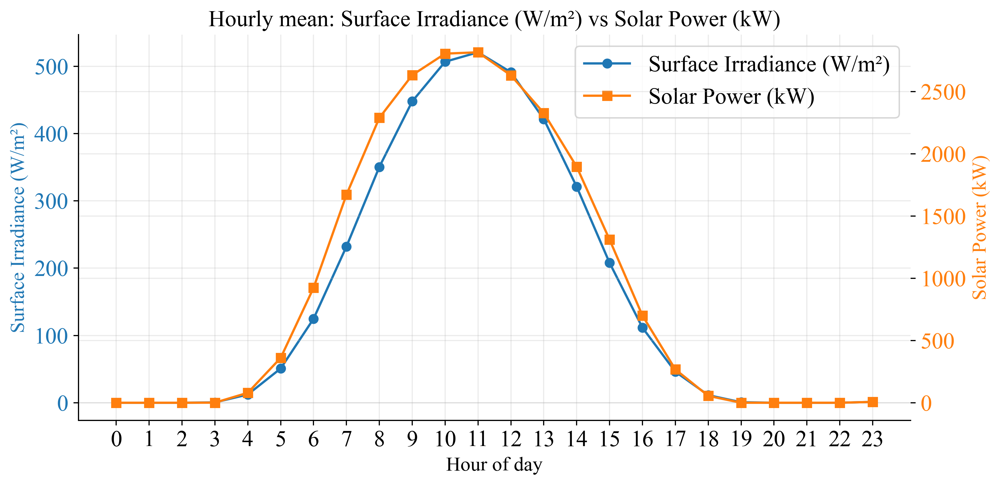

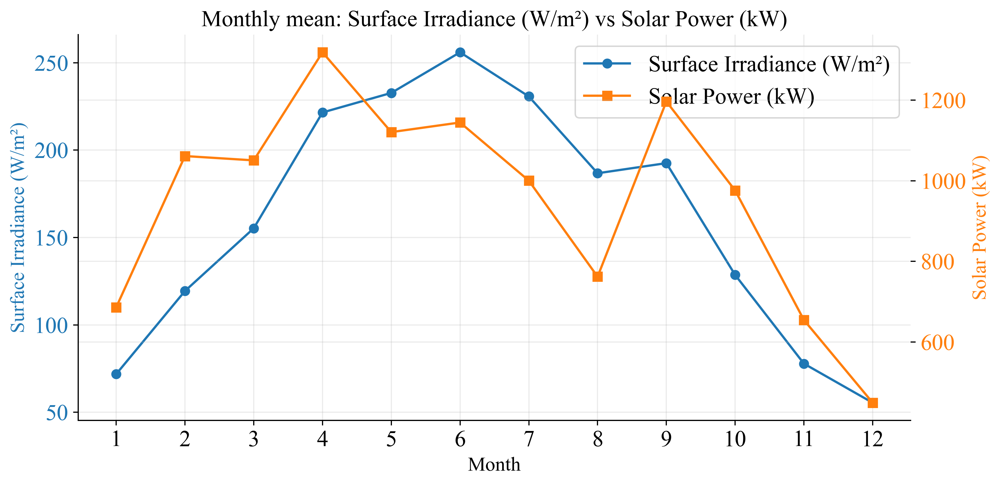

In [ ]:
# ===== Fragment 7b (updated): Dual profiles with distinct colors =====
def plot_dual_hourly(series_left: pd.Series, series_right: pd.Series,
                     name_left: str, name_right: str,
                     xlabel: str = "Hour of day"):
    m_left  = _hourly_means(series_left)
    m_right = _hourly_means(series_right)
    if m_left is None or m_right is None:
        return

    fig = plt.figure(figsize=(10, 5), dpi=350)
    ax1 = plt.gca()
    ax2 = ax1.twinx()

    l1, = ax1.plot(m_left.index,  m_left.values, marker="o", color="tab:blue",  label=name_left)
    l2, = ax2.plot(m_right.index, m_right.values, marker="s", color="tab:orange", label=name_right)

    ax1.set_xlabel(xlabel)
    ax1.set_ylabel(name_left, color="tab:blue")
    ax2.set_ylabel(name_right, color="tab:orange")
    ax1.tick_params(axis="y", labelcolor="tab:blue")
    ax2.tick_params(axis="y", labelcolor="tab:orange")
    ax1.set_xticks(range(0, 24, 1))
    ax1.set_title(f"Hourly mean: {name_left} vs {name_right}")

    ax1.legend(handles=[l1, l2], loc="best")
    fig.tight_layout()
    plt.show()

def plot_dual_monthly(series_left: pd.Series, series_right: pd.Series,
                      name_left: str, name_right: str,
                      xlabel: str = "Month"):
    m_left  = _monthly_means(series_left)
    m_right = _monthly_means(series_right)
    if m_left is None or m_right is None:
        return

    fig = plt.figure(figsize=(10, 5), dpi=350)
    ax1 = plt.gca()
    ax2 = ax1.twinx()

    l1, = ax1.plot(m_left.index,  m_left.values, marker="o", color="tab:blue",  label=name_left)
    l2, = ax2.plot(m_right.index, m_right.values, marker="s", color="tab:orange", label=name_right)

    ax1.set_xlabel(xlabel)
    ax1.set_ylabel(name_left, color="tab:blue")
    ax2.set_ylabel(name_right, color="tab:orange")
    ax1.tick_params(axis="y", labelcolor="tab:blue")
    ax2.tick_params(axis="y", labelcolor="tab:orange")
    ax1.set_xticks(range(1, 13))
    ax1.set_title(f"Monthly mean: {name_left} vs {name_right}")

    ax1.legend(handles=[l1, l2], loc="best")
    fig.tight_layout()
    plt.show()


# --------- Calls ---------
if wind_target and ("wind_speed_wind" in df.columns):
    plot_dual_hourly(df["wind_speed_wind"], df[wind_target],
                     name_left="Wind Speed (m/s)", name_right="Wind Power (kW)")
    plot_dual_monthly(df["wind_speed_wind"], df[wind_target],
                      name_left="Wind Speed (m/s)", name_right="Wind Power (kW)")

irr_col = None
for c in ["surface_irradiance_solar", "irradiance_solar", "toa_irradiance_solar"]:
    if c in df.columns:
        irr_col = c
        break
if solar_target and irr_col:
    irr_name = "Surface Irradiance (W/m²)" if irr_col=="surface_irradiance_solar" else "Irradiance (W/m²)"
    plot_dual_hourly(df[irr_col], df[solar_target],
                     name_left=irr_name, name_right="Solar Power (kW)")
    plot_dual_monthly(df[irr_col], df[solar_target],
                      name_left=irr_name, name_right="Solar Power (kW)")


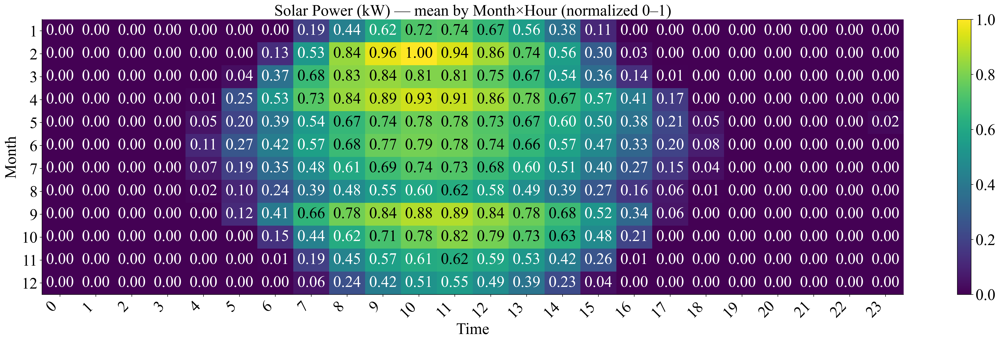

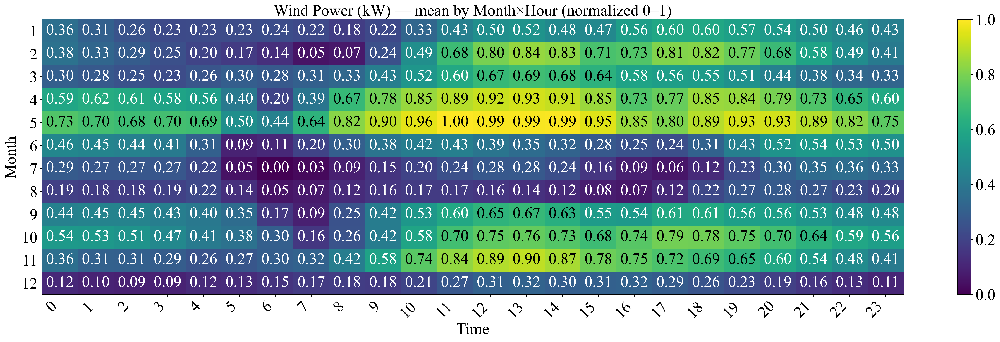

In [ ]:
# ===== Fragment 8: Hour×Month heatmaps (0–1 normalized, correct Ox/Oy labels) =====
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from contextlib import contextmanager

def _minmax01(arr: np.ndarray) -> np.ndarray:
    v = np.array(arr, dtype=float)
    vmin = np.nanmin(v); vmax = np.nanmax(v)
    if not np.isfinite(vmin) or not np.isfinite(vmax) or vmax == vmin:
        return np.zeros_like(v)
    return (v - vmin) / (vmax - vmin)

@contextmanager
def _suppress_show():
    """Временно отключаем plt.show(), чтобы не потерять фигуру внутри heatmap_with_ann."""
    _old = plt.show
    try:
        plt.show = lambda *a, **k: None
        yield
    finally:
        plt.show = _old

def _pick_heatmap_ax(fig):
  
    axes = [ax for ax in fig.axes if getattr(ax, "images", [])]
    if axes:
        return axes[0]

    for ax in fig.axes[::-1]:
        if ax.get_navigate():   
            return ax
    return fig.axes[-1] if fig.axes else plt.gca()

def month_hour_heatmap(series: pd.Series, title: str,
                       font_size: int = 14,
                       figsize=(25, 8),
                       dpi: int = 350,
                       fmt: str = "{:.2f}"):
    # backup rcParams
    _bak = {k: plt.rcParams[k] for k in [
        "font.size","axes.titlesize","axes.labelsize",
        "xtick.labelsize","ytick.labelsize","legend.fontsize"
    ]}
    try:
        plt.rcParams.update({
            "font.size": font_size,
            "axes.titlesize": font_size,
            "axes.labelsize": font_size,
            "xtick.labelsize": font_size,
            "ytick.labelsize": font_size,
            "legend.fontsize": font_size,
        })

        s = pd.to_numeric(series, errors="coerce")
        tmp = pd.DataFrame({"val": s, "month": df["month"], "hour": df["hour"]}).dropna()
        if tmp.empty:
            return

        piv = (tmp.pivot_table(index="month", columns="hour", values="val", aggfunc="mean")
                 .sort_index()
                 .reindex(columns=sorted(tmp["hour"].unique())))
        piv01 = pd.DataFrame(_minmax01(piv.values), index=piv.index, columns=piv.columns)


        before_ids = set(plt.get_fignums())
        with _suppress_show():
            heatmap_with_ann(
                piv01.values,
                xlabels=piv01.columns, ylabels=piv01.index,
                title=title + " (normalized 0–1)",
                figsize=figsize, dpi=dpi, fmt=fmt
            )

        after_ids = set(plt.get_fignums())
        new_ids = sorted(after_ids - before_ids)
        fig = plt.figure(new_ids[-1]) if new_ids else plt.gcf()
        ax = _pick_heatmap_ax(fig)

        ax.set_xlabel("Time", fontsize=font_size)
        ax.set_ylabel("Month", fontsize=font_size)

        fig.tight_layout()
        plt.show() 
    finally:
        plt.rcParams.update(_bak)

FONT_SIZE = 25
if solar_target:
    month_hour_heatmap(df[solar_target], "Solar Power (kW) — mean by Month×Hour", font_size=FONT_SIZE)
if wind_target:
    month_hour_heatmap(df[wind_target],  "Wind Power (kW) — mean by Month×Hour",  font_size=FONT_SIZE)


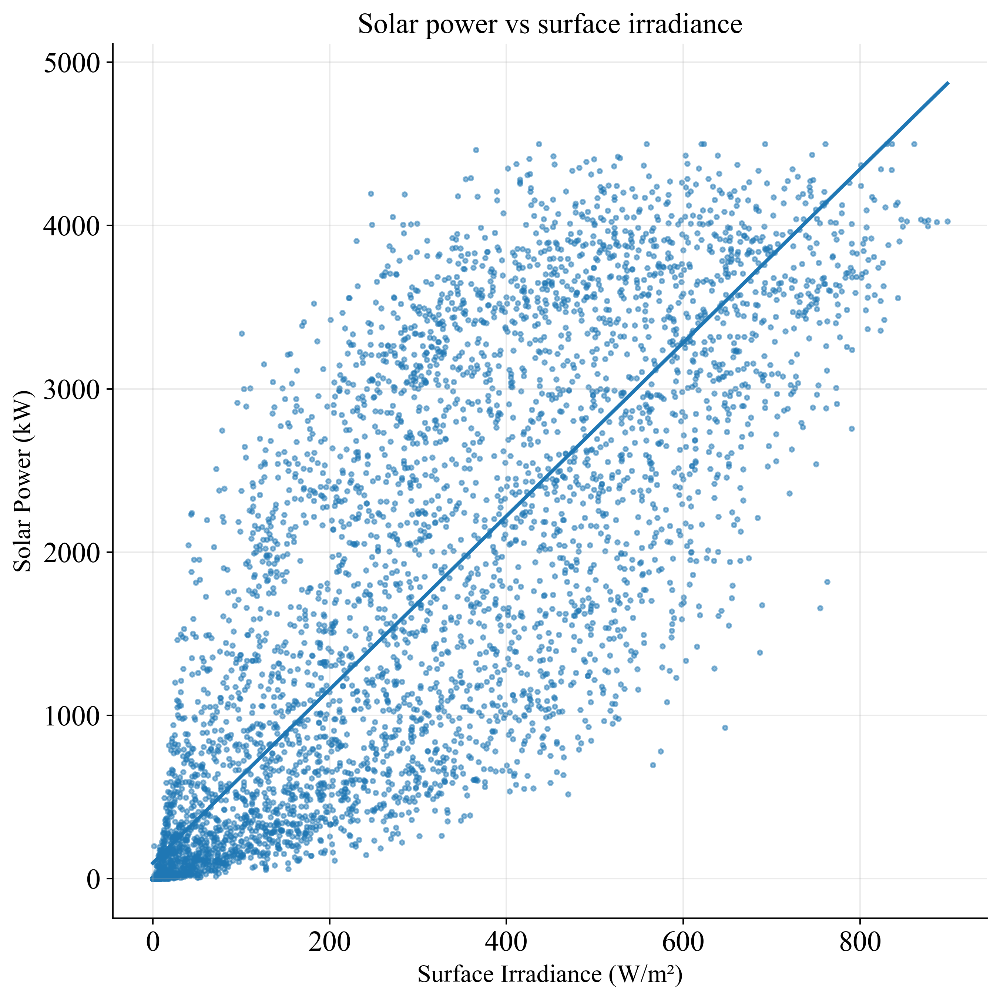

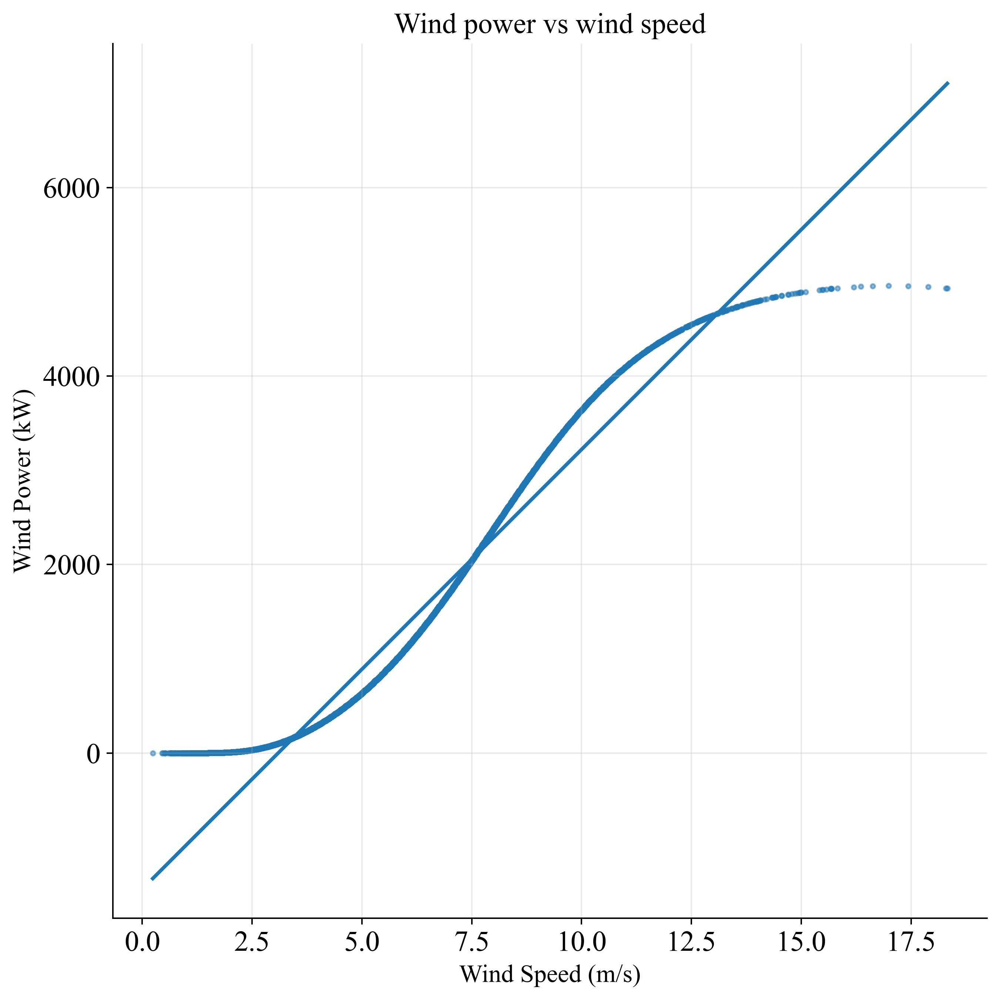

In [ ]:
# ===== Fragment 9: Scatter & simple fits =====
def scatter_with_fit(x, y, xlabel, ylabel, title):
    xs = pd.to_numeric(x, errors="coerce")
    ys = pd.to_numeric(y, errors="coerce")
    m = pd.DataFrame({"x": xs, "y": ys}).dropna()
    if m.empty:
        return
    fig = plt.figure(figsize=(8, 8), dpi=350)
    plt.scatter(m["x"], m["y"], s=6, alpha=0.5)
    try:
        coeffs = np.polyfit(m["x"], m["y"], deg=1)
        xline = np.linspace(m["x"].min(), m["x"].max(), 200)
        yline = coeffs[0]*xline + coeffs[1]
        plt.plot(xline, yline, linewidth=2)
    except Exception:
        pass
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.tight_layout()
    plt.show()

if solar_target and "surface_irradiance_solar" in df.columns:
    scatter_with_fit(df["surface_irradiance_solar"], df[solar_target],
                     "Surface Irradiance (W/m²)", "Solar Power (kW)",
                     "Solar power vs surface irradiance")

if wind_target and "wind_speed_wind" in df.columns:
    scatter_with_fit(df["wind_speed_wind"], df[wind_target],
                     "Wind Speed (m/s)", "Wind Power (kW)",
                     "Wind power vs wind speed")


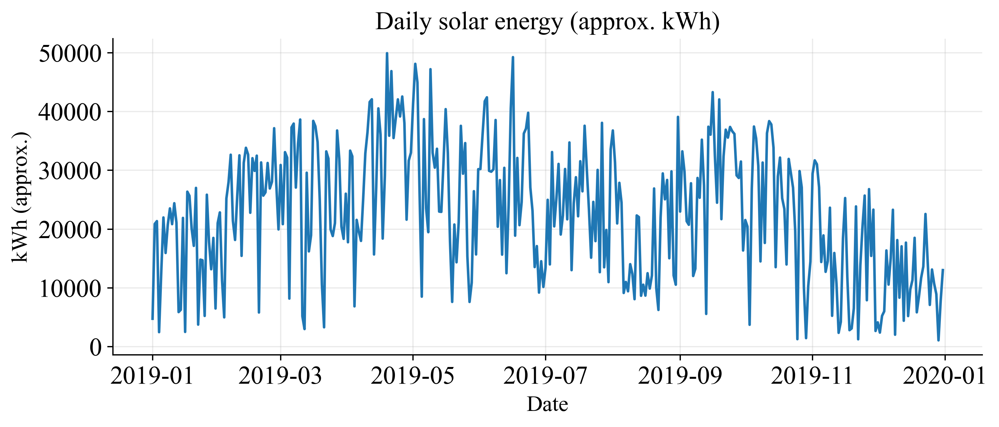

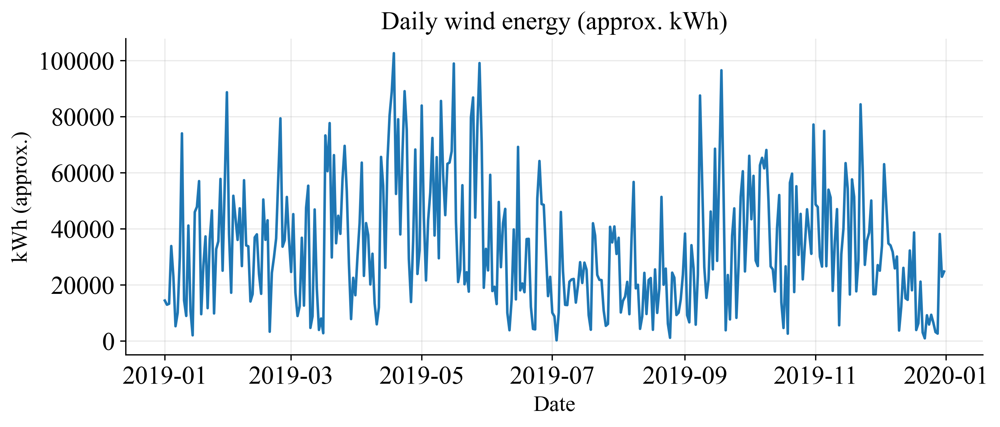

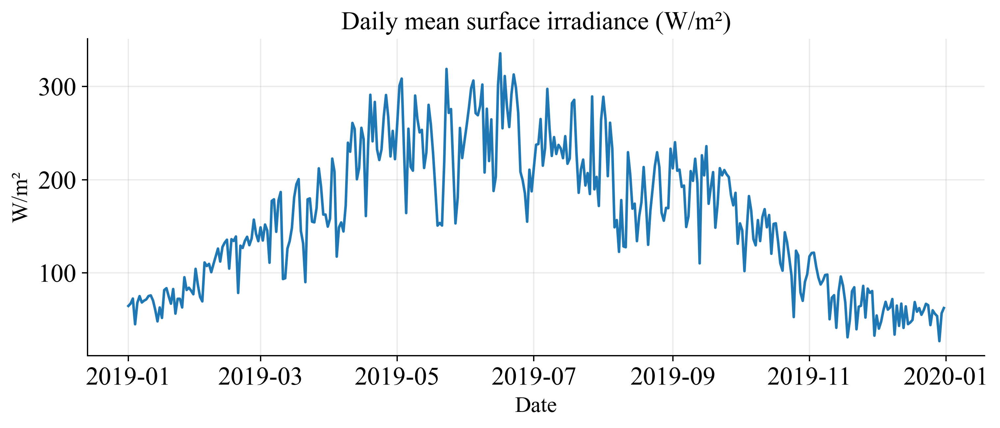

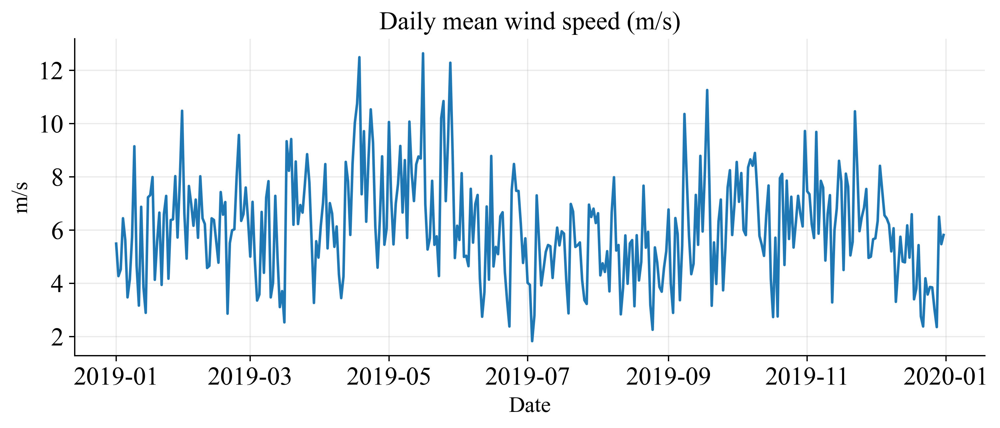

In [ ]:
# ===== Fragment 10: Time series (daily aggregates) =====
if "timestamp" in df.columns:
    idx = pd.to_datetime(df["timestamp"], errors="coerce")
    if solar_target:
        daily_solar = pd.Series(pd.to_numeric(df[solar_target], errors="coerce").values, index=idx).resample("D").sum()
        fig = plt.figure(figsize=(9, 4), dpi=350)
        plt.plot(daily_solar.index, daily_solar.values)
        plt.title("Daily solar energy (approx. kWh)")
        plt.xlabel("Date")
        plt.ylabel("kWh (approx.)")
        plt.tight_layout()
        plt.show()

    if wind_target:
        daily_wind = pd.Series(pd.to_numeric(df[wind_target], errors="coerce").values, index=idx).resample("D").sum()
        fig = plt.figure(figsize=(9, 4), dpi=350)
        plt.plot(daily_wind.index, daily_wind.values)
        plt.title("Daily wind energy (approx. kWh)")
        plt.xlabel("Date")
        plt.ylabel("kWh (approx.)")
        plt.tight_layout()
        plt.show()

    if "surface_irradiance_solar" in df.columns:
        daily_irr = pd.Series(pd.to_numeric(df["surface_irradiance_solar"], errors="coerce").values, index=idx).resample("D").mean()
        fig = plt.figure(figsize=(9, 4), dpi=350)
        plt.plot(daily_irr.index, daily_irr.values)
        plt.title("Daily mean surface irradiance (W/m²)")
        plt.xlabel("Date")
        plt.ylabel("W/m²")
        plt.tight_layout()
        plt.show()

    if "wind_speed_wind" in df.columns:
        daily_ws = pd.Series(pd.to_numeric(df["wind_speed_wind"], errors="coerce").values, index=idx).resample("D").mean()
        fig = plt.figure(figsize=(9, 4), dpi=350)
        plt.plot(daily_ws.index, daily_ws.values)
        plt.title("Daily mean wind speed (m/s)")
        plt.xlabel("Date")
        plt.ylabel("m/s")
        plt.tight_layout()
        plt.show()


In [ ]:
# ===== Fragment 11: Physical sanity checks =====
def report_count(name, cond):
    n = int(cond.sum())
    print(f"{name}: {n}")

if "hour" in df.columns:
    night = df["hour"].isin([0,1,2,3,4,5,20,21,22,23])

    if "surface_irradiance_solar" in df.columns:
        irr = pd.to_numeric(df["surface_irradiance_solar"], errors="coerce")
        report_count("Night irradiance > 0", (irr > 0) & night)

    if solar_target:
        sp = pd.to_numeric(df[solar_target], errors="coerce")
        report_count("Night solar power > 0", (sp > 0) & night)

if "wind_speed_wind" in df.columns:
    ws = pd.to_numeric(df["wind_speed_wind"], errors="coerce")
    report_count("Negative wind speed", ws < 0)

if solar_target:
    sp = pd.to_numeric(df[solar_target], errors="coerce")
    report_count("Negative solar power", sp < 0)

if wind_target:
    wp = pd.to_numeric(df[wind_target], errors="coerce")
    report_count("Negative wind power", wp < 0)


Night irradiance > 0: 579
Night solar power > 0: 354
Negative wind speed: 0
Negative solar power: 0
Negative wind power: 0


In [ ]:
# ===== Fragment 12: Modeling prep (skeleton) =====


feature_candidates = []
feature_candidates += solar_feats
feature_candidates += wind_feats

for c in ["month", "hour", "doy"]:
    if c in df.columns:
        feature_candidates.append(c)
m = df.dropna(subset=["timestamp"]).copy()
m = m.drop_duplicates(subset=["timestamp"])


def make_Xy(data: pd.DataFrame, target_col: str, features: list):
    X = data[features].copy()
    y = pd.to_numeric(data[target_col], errors="coerce")
    mask = (~y.isna())
    for c in X.columns:
        mask &= ~X[c].isna()
    X = X[mask]
    y = y[mask]
    return X, y

X_solar, y_solar = (None, None)
X_wind,  y_wind  = (None, None)

if solar_target:
    X_solar, y_solar = make_Xy(m, solar_target, [c for c in feature_candidates if c in m.columns])
    print("Solar X/y:", X_solar.shape, y_solar.shape)

if wind_target:
    X_wind, y_wind = make_Xy(m, wind_target, [c for c in feature_candidates if c in m.columns])
    print("Wind  X/y:", X_wind.shape, y_wind.shape)

def time_split(df_like: pd.DataFrame, frac_test=0.2):
    n = len(df_like)
    cut = int(np.floor(n*(1-frac_test)))
    idx = np.arange(n)
    return idx[:cut], idx[cut:]

if X_solar is not None:
    idx_tr, idx_te = time_split(X_solar, 0.2)
    print("Solar split:", len(idx_tr), "train /", len(idx_te), "test")

if X_wind is not None:
    idx_tr, idx_te = time_split(X_wind, 0.2)
    print("Wind split:", len(idx_tr), "train /", len(idx_te), "test")


Solar X/y: (8752, 11) (8752,)
Wind  X/y: (8752, 11) (8752,)
Solar split: 7001 train / 1751 test
Wind split: 7001 train / 1751 test


In [ ]:
# ===== Fragment 13: Tables for the paper =====
def seasonal_stats(series: pd.Series, name: str):
    s = pd.to_numeric(series, errors="coerce")
    t = pd.DataFrame({"val": s, "season": df["season_derived"]}).dropna()
    if t.empty:
        return
    g = t.groupby("season")["val"].agg(["count","mean","std","min","max"])
    print(f"\nSeasonal stats — {name}")
    print(g)

def monthly_stats(series: pd.Series, name: str):
    s = pd.to_numeric(series, errors="coerce")
    t = pd.DataFrame({"val": s, "month": df["month"]}).dropna()
    if t.empty:
        return
    g = t.groupby("month")["val"].agg(["count","mean","std","min","max"])
    print(f"\nMonthly stats — {name}")
    print(g)

if solar_target:
    seasonal_stats(df[solar_target], "Solar Power (kW)")
    monthly_stats(df[solar_target], "Solar Power (kW)")

if wind_target:
    seasonal_stats(df[wind_target], "Wind Power (kW)")
    monthly_stats(df[wind_target], "Wind Power (kW)")

def table_top_corr(target, k=10, method="pearson"):
    if (target is None) or (target not in df.columns):
        return
    num_df = df.select_dtypes(include=[np.number]).copy()
    corr = num_df.corr(method=method)[target].drop(target).sort_values(ascending=False)
    top = corr.head(k).to_frame(f"corr_with_{target}_{method}")
    print(top)

table_top_corr(solar_target, 10, "pearson")
table_top_corr(solar_target, 10, "spearman")
table_top_corr(wind_target,  10, "pearson")
table_top_corr(wind_target,  10, "spearman")



Seasonal stats — Solar Power (kW)
        count         mean          std  min       max
season                                                
autumn   2184   942.717727  1377.896308  0.0  4238.193
spring   2209  1161.535002  1462.703420  0.0  4500.000
summer   2208   966.957184  1200.696901  0.0  4036.684
winter   2152   721.235507  1237.513954  0.0  4500.000

Monthly stats — Solar Power (kW)
       count         mean          std  min       max
month                                                
1        736   685.842629  1177.053979  0.0  4005.425
2        672  1061.194115  1543.353973  0.0  4500.000
3        744  1050.507254  1467.837257  0.0  4500.000
4        720  1318.606440  1544.096468  0.0  4500.000
5        745  1120.613136  1362.291924  0.0  4300.442
6        720  1144.471549  1320.815891  0.0  4036.684
7        744  1000.190301  1185.015244  0.0  3742.922
8        744   761.935972  1056.473145  0.0  3886.848
9        720  1196.589754  1485.146683  0.0  4197.958
10     

In [ ]:
# --- in english auto-detect target names (support for kW/kWt and different suffixes) ---
def _find_target(cols, suffix):
    cands = [c for c in cols if c.lower().endswith(suffix) and ("kw" in c.lower()) and ("power" in c.lower())]
    if cands: return cands[0]
    # backup option: any "power_*suffix"
    cands = [c for c in cols if c.lower().endswith(suffix) and ("power" in c.lower())]
    return cands[0] if cands else None

cols = df.columns.tolist()
target_solar = _find_target(cols, "_solar")  # e.g., 'kW_solar_power_solar' or 'kWt_solar_power_solar'
target_wind  = _find_target(cols, "_wind")   # e.g., 'kW_wind_power_wind' or 'kWt_wind_power_wind'

assert target_solar is not None, "Target column for solar not found"
assert target_wind  is not None, "Target column for wind not found"

# --- candidates for features (both targets use the same pool) ---
base_feature_keys = [
    # solar
    "surface_irradiance_solar","toa_irradiance_solar","irradiance_solar",
    "temperature_solar","module_temperature_solar",
    "humidity_solar","relative_humidity_solar","specific_humidity_solar",
    # wind
    "wind_speed_wind","wind_direction_wind","air_density_wind",
    # calendar (if available)
    "hour","month","doy"
]
features_all = [c for c in base_feature_keys if c in df.columns]

# --- strict filtering of missing values: only rows with ALL features_all and both targets ---
m = df.dropna(subset=features_all + [target_solar, target_wind]).copy()

# general X, separate y
X = m[features_all].copy()
y_solar = m[target_solar].astype(float)
y_wind  = m[target_wind].astype(float)

print("Targets:", target_solar, "|", target_wind)
print("Shared features:", features_all)
print("Shapes:", X.shape, y_solar.shape, y_wind.shape)

# ---  simple time split (last 20% for testing) ---
def time_split(n, frac_test=0.2):
    cut = int(n * (1 - frac_test))
    idx_tr = np.arange(cut)
    idx_te = np.arange(cut, n)
    return idx_tr, idx_te

idx_tr, idx_te = time_split(len(X), 0.2)
Xtr, Xte = X.iloc[idx_tr], X.iloc[idx_te]
ys_tr, ys_te = y_solar.iloc[idx_tr], y_solar.iloc[idx_te]
yw_tr, yw_te = y_wind.iloc[idx_tr],  y_wind.iloc[idx_te]


Targets: kWh_solar_power_solar | kWh_wind_power_wind
Shared features: ['surface_irradiance_solar', 'toa_irradiance_solar', 'temperature_solar', 'humidity_solar', 'relative_humidity_solar', 'specific_humidity_solar', 'wind_speed_wind', 'air_density_wind', 'hour', 'month', 'doy']
Shapes: (8753, 11) (8753,) (8753,)


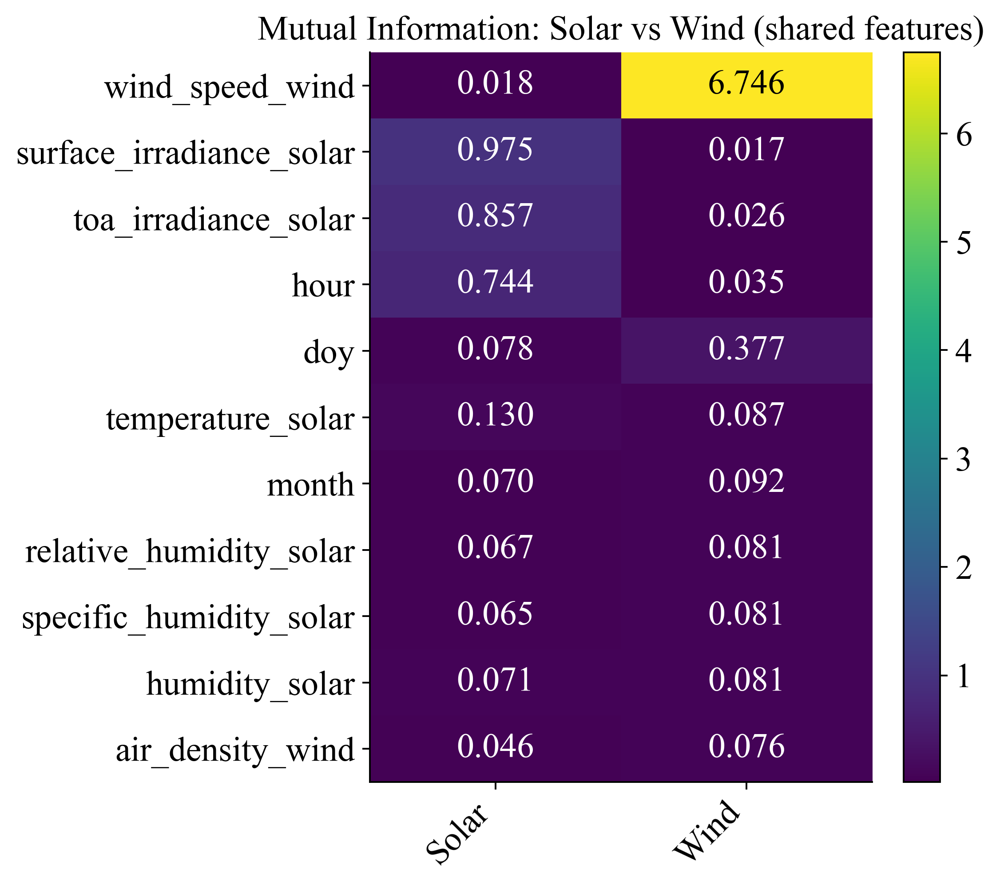

In [ ]:
from sklearn.feature_selection import mutual_info_regression
from sklearn.preprocessing import QuantileTransformer
import numpy as np
import matplotlib.pyplot as plt



# Small normalization (robust to outliers)
qt = QuantileTransformer(output_distribution="normal", random_state=42)
Xtr_q = qt.fit_transform(Xtr)
Xte_q = qt.transform(Xte)

def mi_vector(Xq, y):
    # mutual_info_regression returns MI(feature_i; y)
    return mutual_info_regression(Xq, y.to_numpy(), random_state=42)

# MI for solar/wind
mi_solar = mi_vector(Xtr_q, ys_tr)
mi_wind  = mi_vector(Xtr_q, yw_tr)

# === Combined MI heatmap: features (Y) x targets (X: Solar, Wind) ===
def mi_combined_heatmap(mi_solar, mi_wind, feat_names,
                        title="Mutual Information with Solar/Wind",
                        sort_by="max"):  # sort_by: "max" | "solar" | "wind" | None
    import numpy as np

    # Matrix [n_features x 2]
    M = np.column_stack([np.asarray(mi_solar, float),
                         np.asarray(mi_wind,  float)])


    if sort_by == "max":
        order = np.argsort(M.max(axis=1))[::-1]
    elif sort_by == "solar":
        order = np.argsort(M[:, 0])[::-1]
    elif sort_by == "wind":
        order = np.argsort(M[:, 1])[::-1]
    else:
        order = np.arange(M.shape[0])

    M_sorted = M[order, :]
    feats_sorted = [feat_names[i] for i in order]


    heatmap_with_ann(
        M_sorted,
        xlabels=["Solar", "Wind"],
        ylabels=feats_sorted,
        title=title,
        figsize=(6.8, max(6, 0.45 * len(feats_sorted))),
        dpi=350,
        fmt="{:.3f}",
    )

# Вызов:
mi_combined_heatmap(mi_solar, mi_wind, features_all,
                    title="Mutual Information: Solar vs Wind (shared features)",
                    sort_by="max")


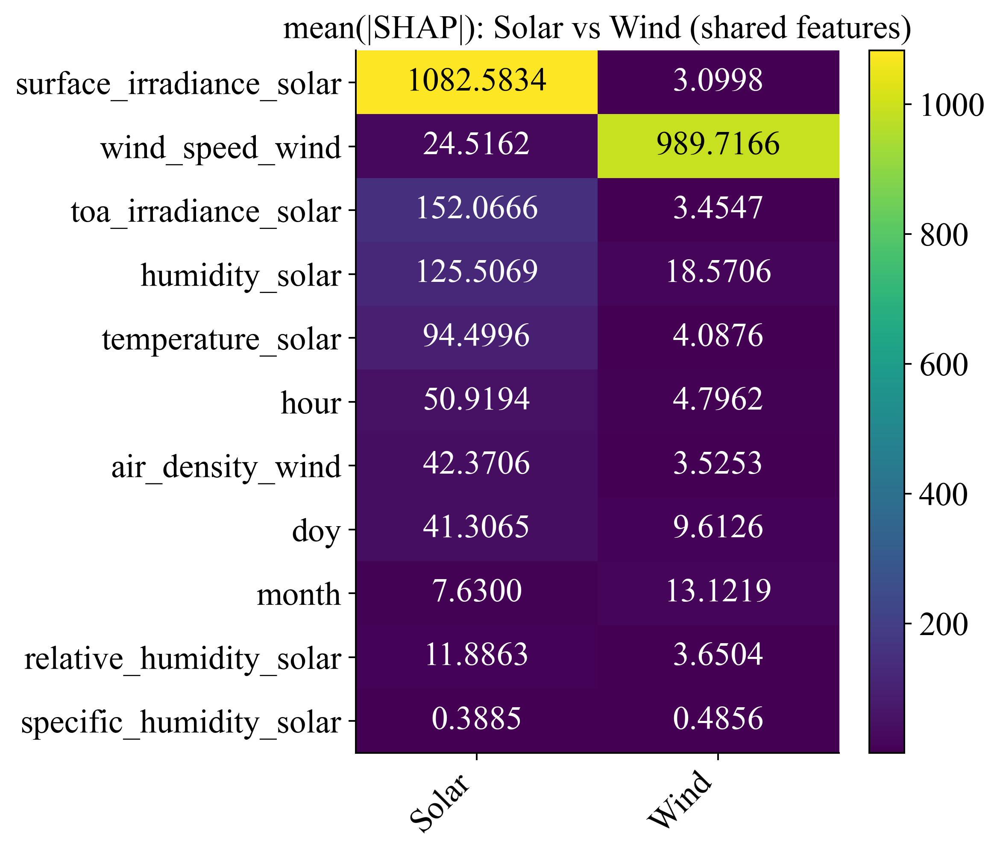

In [ ]:
from xgboost import XGBRegressor
import numpy as np
import matplotlib.pyplot as plt

xgb_params = dict(
    n_estimators=400, max_depth=6, learning_rate=0.05,
    subsample=0.9, colsample_bytree=0.9, reg_lambda=1.0,
    random_state=42, tree_method="hist"
)

xgb_solar = XGBRegressor(**xgb_params)
xgb_wind  = XGBRegressor(**xgb_params)

xgb_solar.fit(Xtr, ys_tr)
xgb_wind.fit(Xtr, yw_tr)

def mean_abs_shap(model, Xsample, feat_names):
    try:
        import shap
        expl = shap.TreeExplainer(model)
        sv = expl.shap_values(Xsample, check_additivity=False)  
        mean_abs = np.abs(sv).mean(axis=0)
        return mean_abs
    except Exception:

        booster = model.get_booster()
        fmap = booster.get_fscore(importance_type="gain")
        arr = np.array([fmap.get(f"f{i}", 0.0) for i in range(len(feat_names))], dtype=float)
        if arr.sum() > 0: arr = arr / arr.sum()
        return arr


ns = min(8000, len(Xtr))
Xsub = Xtr.sample(ns, random_state=42)

shap_solar = mean_abs_shap(xgb_solar, Xsub, features_all)
shap_wind  = mean_abs_shap(xgb_wind,  Xsub, features_all)

def shap_combined_heatmap(shap_solar, shap_wind, feat_names,
                          title="XGBoost non-linear importance — mean(|SHAP|)",
                          sort_by="max"): 
    import numpy as np

    M = np.column_stack([np.asarray(shap_solar, float),
                         np.asarray(shap_wind,  float)])

    if sort_by == "max":
        order = np.argsort(M.max(axis=1))[::-1]
    elif sort_by == "solar":
        order = np.argsort(M[:, 0])[::-1]
    elif sort_by == "wind":
        order = np.argsort(M[:, 1])[::-1]
    else:
        order = np.arange(M.shape[0])

    M_sorted = M[order, :]
    feats_sorted = [feat_names[i] for i in order]

    heatmap_with_ann(
        M_sorted,
        xlabels=["Solar", "Wind"],
        ylabels=feats_sorted,
        title=title,
        figsize=(6.8, max(6, 0.45 * len(feats_sorted))),
        dpi=350,
        fmt="{:.4f}",
    )

shap_combined_heatmap(shap_solar, shap_wind, features_all,
                      title="mean(|SHAP|): Solar vs Wind (shared features)",
                      sort_by="max")



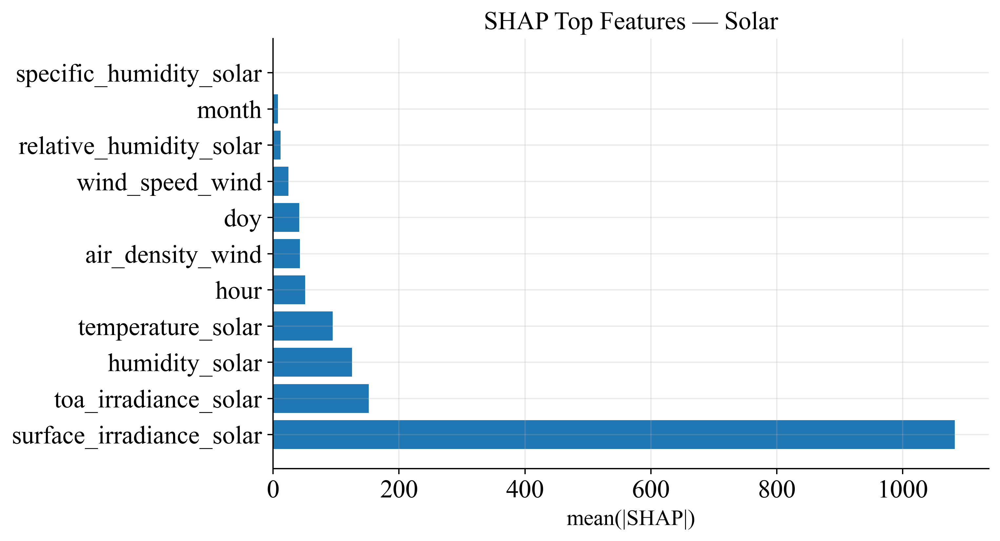

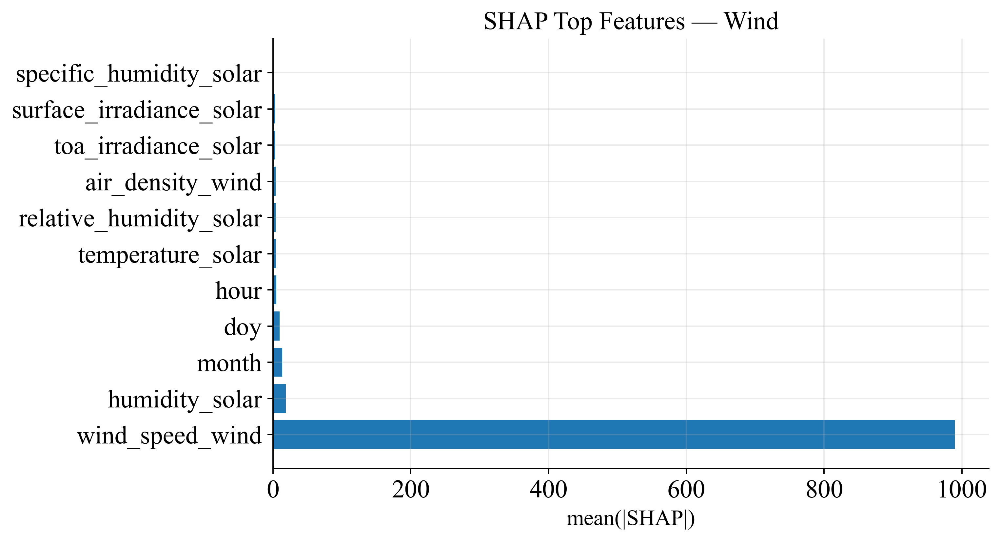

In [ ]:
def shap_top_bar(shap_vals, feat_names, title, topn=15):
    order = np.argsort(shap_vals)[::-1][:topn]
    vals  = shap_vals[order]
    labs  = [feat_names[i] for i in order]

    fig = plt.figure(figsize=(9, max(5, 0.45*len(labs))), dpi=350)
    ax = plt.gca()
    ax.barh(labs[::-1], vals[::-1]) 
    ax.set_title(title)
    ax.set_xlabel("mean(|SHAP|)")
    ax.invert_yaxis()
    plt.tight_layout()
    plt.show()

shap_top_bar(shap_solar, features_all, "SHAP Top Features — Solar", topn=min(15, len(features_all)))
shap_top_bar(shap_wind,  features_all, "SHAP Top Features — Wind",  topn=min(15, len(features_all)))


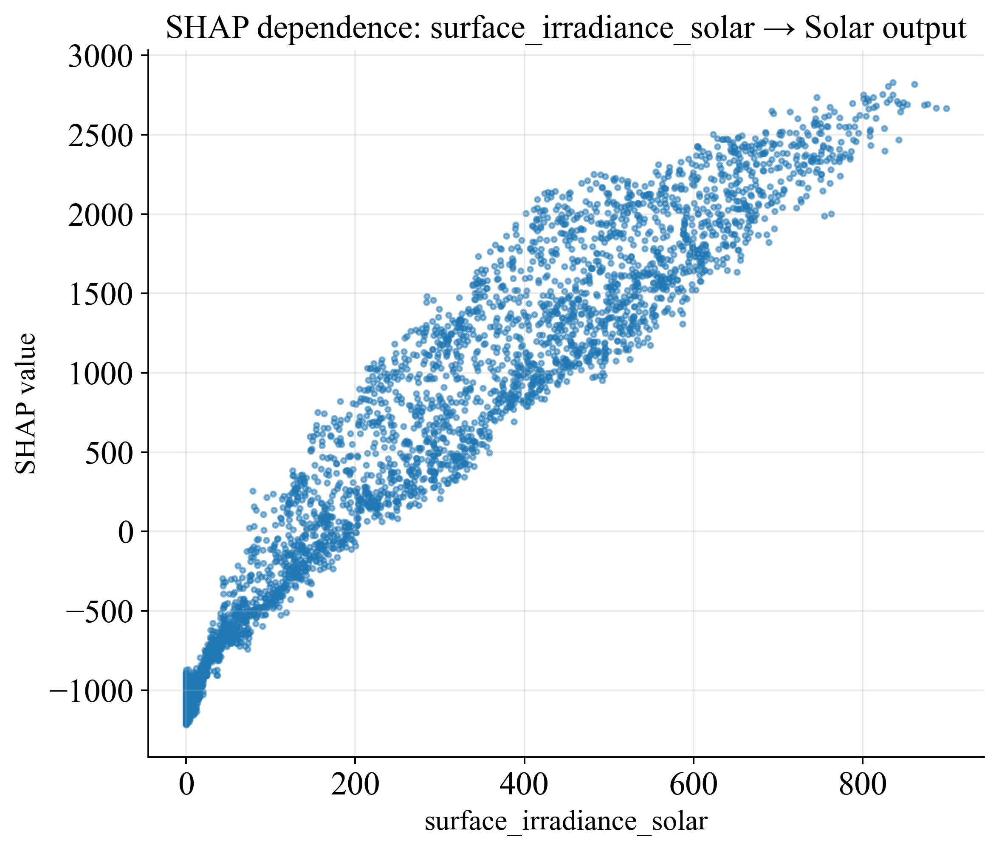

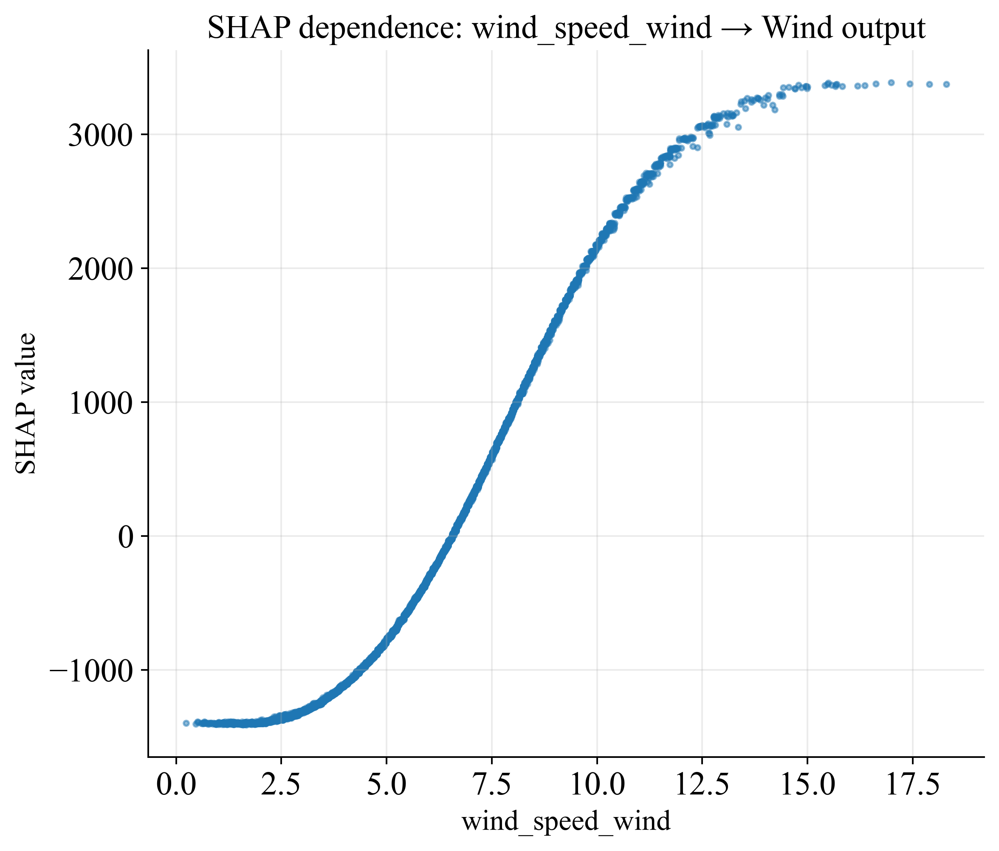

In [ ]:
def shap_dependence(model, Xframe, feature_name, title):
    import shap
    expl = shap.TreeExplainer(model)
    Xs = Xframe.sample(min(6000, len(Xframe)), random_state=42)
    sv = expl.shap_values(Xs, check_additivity=False)
    j = Xs.columns.get_loc(feature_name)
    x = Xs.iloc[:, j].to_numpy()
    y = sv[:, j]

    fig = plt.figure(figsize=(7, 6), dpi=350)
    plt.scatter(x, y, s=6, alpha=0.5)
    plt.xlabel(feature_name)
    plt.ylabel("SHAP value")
    plt.title(title)
    plt.tight_layout()
    plt.show()

if "surface_irradiance_solar" in Xtr.columns:
    shap_dependence(xgb_solar, Xtr, "surface_irradiance_solar",
                    "SHAP dependence: surface_irradiance_solar → Solar output")
if "wind_speed_wind" in Xtr.columns:
    shap_dependence(xgb_wind,  Xtr, "wind_speed_wind",
                    "SHAP dependence: wind_speed_wind → Wind output")


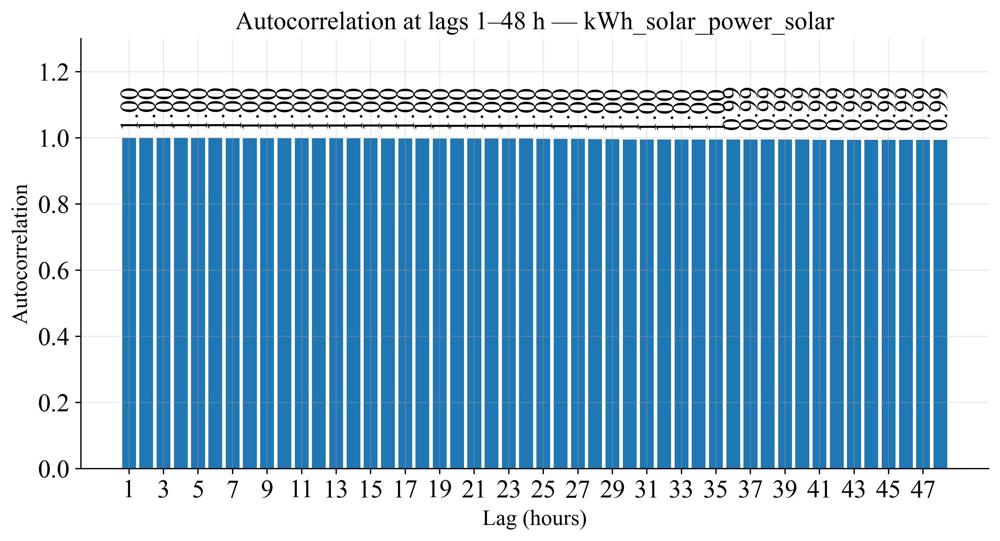

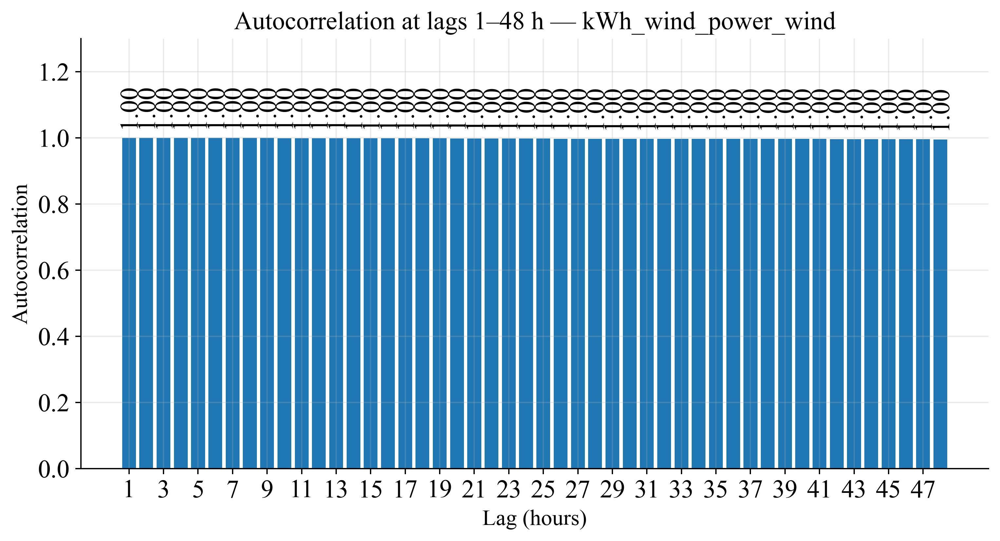

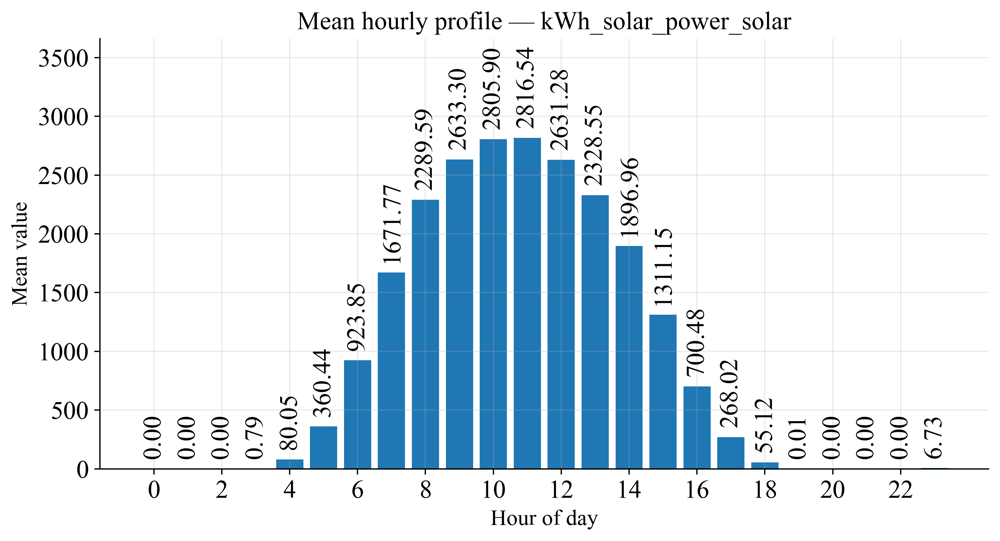

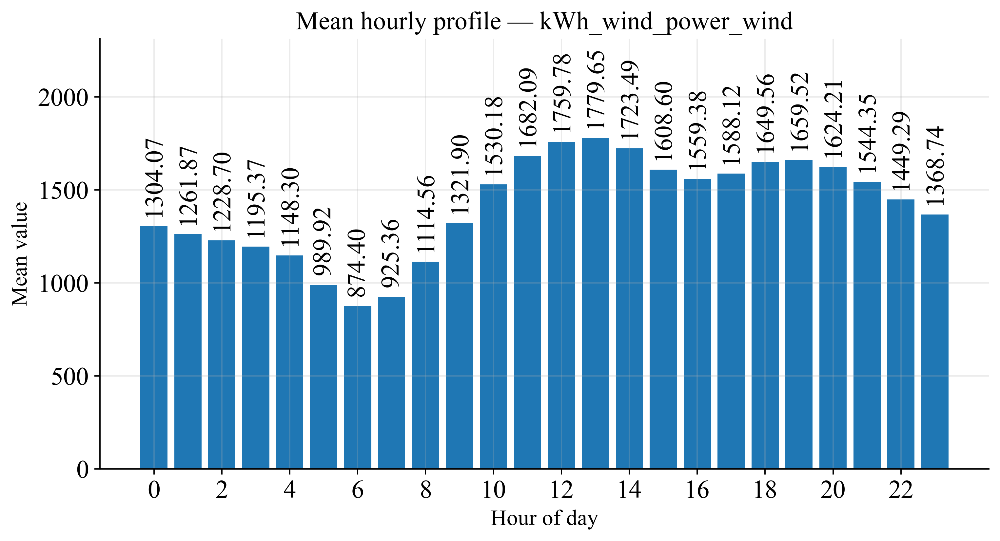

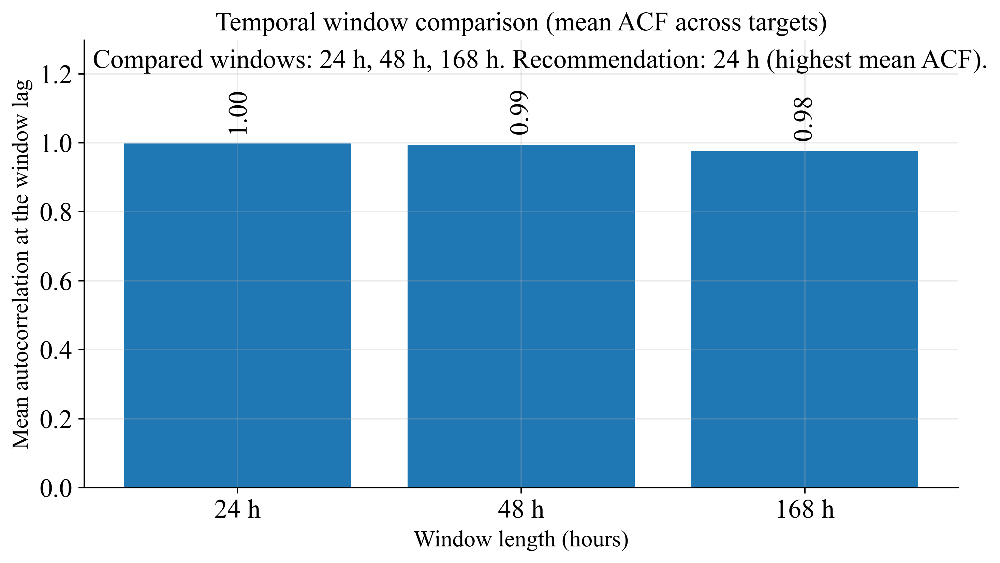

In [ ]:
# ===== Fragment 3 (REVISED): Paper-ready seasonality & window visuals (EN only) =====
# Continues after your Fragment 1. Uses your global mpl.rcParams (Times New Roman, etc.).

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import math

if "df" not in globals():
    raise RuntimeError("DataFrame `df` not found. Run the load fragment first.")
if "timestamp" not in df.columns:
    raise RuntimeError("Column `timestamp` not found in df.")

def annotate_bars_vertical(ax, fmt="{:.2f}", offset_px=6):
    """
    Put vertical labels above each bar, rotated 90°, with pixel offset.
    """
    for rect in ax.patches:
        h = rect.get_height()
        if pd.isna(h):
            continue
        x = rect.get_x() + rect.get_width() / 2.0
        ax.annotate(
            fmt.format(h),
            (x, h),
            ha="center",
            va="bottom" if h >= 0 else "top",
            rotation=90,
            xytext=(0, offset_px), textcoords="offset points",
            clip_on=False,
        )

def add_headroom_30pct(ax):
    heights = [p.get_height() for p in ax.patches if not pd.isna(p.get_height())]
    if not heights:
        return
    top = max(heights)
    if top <= 0:
        return
    ax.set_ylim(0, top * 1.30)

def manual_acf(series: pd.Series, max_lag: int = 336) -> pd.Series:
    s = pd.Series(series, dtype="float64").replace([np.inf, -np.inf], np.nan).dropna()
    if len(s) < max_lag + 2 or s.std(ddof=0) == 0:
        return pd.Series(np.nan, index=range(1, max_lag + 1))
    m = s.mean()
    denom = float(((s - m) ** 2).sum())
    vals = []
    for lag in range(1, max_lag + 1):
        x = s.iloc[:-lag] - m
        y = s.iloc[lag:] - m
        r = float((x * y).sum() / denom)
        vals.append(float(np.clip(r, -1, 1)))
    return pd.Series(vals, index=range(1, max_lag + 1))

def hourly_profile(df: pd.DataFrame, target: str) -> pd.Series:
    tmp = df.loc[:, ["timestamp", target]].dropna()
    if tmp.empty:
        return pd.Series(dtype=float)
    tmp["hour"] = tmp["timestamp"].dt.hour
    return tmp.groupby("hour")[target].mean().reindex(range(24))

# ---------- 1) Frequency diagnostics (hourly expected) ----------
diffs = df["timestamp"].sort_values().diff().dropna()
mins = (diffs.dt.total_seconds() // 60).astype(int)
modal_minutes = int(mins.value_counts().idxmax()) if len(mins) else 60
steps_per_day = max(1, int(round(1440 / modal_minutes)))

# ---------- 2) Targets present ----------
TARGETS = [
    "kWh_solar_power_solar", "kWh_wind_power_wind",
    "kWt_solar_power_solar", "kWt_wind_power_wind",
]
targets_present = [c for c in TARGETS if c in df.columns]

# ---------- 3) FIGURE A — ACF at lags 1–48 h (per target) ----------
# Rationale for paper: demonstrates diurnal seasonality and supports 24 h window.
acf_dict = {}
acf_summary_rows = []
for tgt in targets_present:
    ac = manual_acf(df[tgt], max_lag=336)
    acf_dict[tgt] = ac
    lags = np.arange(1, 49)
    vals = ac.loc[1:48].to_numpy()

    fig = plt.figure(figsize=(9, 5))
    ax = fig.gca()
    ax.bar(lags, vals)
    ax.set_title(f"Autocorrelation at lags 1–48 h — {tgt}")
    ax.set_xlabel("Lag (hours)")
    ax.set_ylabel("Autocorrelation")
    annotate_bars_vertical(ax, fmt="{:.2f}", offset_px=6)
    add_headroom_30pct(ax)
    ax.set_xticks(lags[::2]) 
    plt.tight_layout()
    plt.show()

    ac24  = float(ac.get(24, np.nan))
    ac48  = float(ac.get(48, np.nan))
    ac168 = float(ac.get(168, np.nan))
    best_1_48 = int(ac.loc[1:48].idxmax()) if ac.loc[1:48].notna().any() else None
    best_1_48_val = float(ac.loc[best_1_48]) if best_1_48 is not None else None

    acf_summary_rows.append({
        "series": tgt,
        "ACF@24h": None if np.isnan(ac24) else round(ac24, 4),
        "ACF@48h": None if np.isnan(ac48) else round(ac48, 4),
        "ACF@168h": None if np.isnan(ac168) else round(ac168, 4),
        "Best lag (1–48h)": best_1_48,
        "Best ACF (1–48h)": None if best_1_48_val is None else round(best_1_48_val, 4),
    })
acf_summary_df = pd.DataFrame(acf_summary_rows)

# ---------- 4) FIGURE B — Mean hourly profile (0–23 h, per target) ----------
# Rationale for paper: compact diurnal shape confirmation (complements ACF).
for tgt in targets_present:
    prof = hourly_profile(df, tgt)
    if prof.empty:
        continue
    x = prof.index.to_numpy()
    y = prof.values

    fig = plt.figure(figsize=(9, 5))
    ax = fig.gca()
    ax.bar(x, y)
    ax.set_title(f"Mean hourly profile — {tgt}")
    ax.set_xlabel("Hour of day")
    ax.set_ylabel("Mean value")
    annotate_bars_vertical(ax, fmt="{:.2f}", offset_px=6)
    add_headroom_30pct(ax)
    ax.set_xticks(range(0, 24, 2))
    plt.tight_layout()
    # plt.savefig(f"FIG_B_Hourly_Profile_{tgt}.png")
    plt.show()

# ---------- 5) FIGURE C — Window comparison & recommendation ----------
candidates = [24, 48, 168]
if steps_per_day not in candidates:
    candidates = [steps_per_day] + candidates
candidates = sorted(dict.fromkeys(candidates))  # unique & sorted

def mean_acf_at_lag(lag: int) -> float:
    vals = []
    for tgt, ac in acf_dict.items():
        v = ac.get(lag, np.nan)
        if not np.isnan(v):
            vals.append(float(v))
    return float(np.mean(vals)) if vals else np.nan

scores = {lag: mean_acf_at_lag(lag) for lag in candidates}
# Recommendation = argmax mean ACF among the compared windows
recommended_window = max(scores.items(), key=lambda kv: (kv[1] if not np.isnan(kv[1]) else -np.inf))[0]

labels = [f"{lag} h" for lag in candidates]
values = [scores[lag] for lag in candidates]

fig = plt.figure(figsize=(9, 5))
ax = fig.gca()
ax.bar(labels, values)
ax.set_title("Temporal window comparison (mean ACF across targets)")
ax.set_xlabel("Window length (hours)")
ax.set_ylabel("Mean autocorrelation at the window lag")
annotate_bars_vertical(ax, fmt="{:.2f}", offset_px=6)
add_headroom_30pct(ax)


caption = (
    "Compared windows: " + ", ".join([f"{lag} h" for lag in candidates]) + ". "
    f"Recommendation: {recommended_window} h (highest mean ACF)."
)
ax.text(0.01, 0.98, caption, transform=ax.transAxes, ha="left", va="top")

plt.tight_layout()
plt.show()



# TRAIN MODELS Train/Test Split and CrossValidation on 5-Fold

In [22]:
# ===== Fragment 0 — Shared Utilities (keep df, features_all, y_solar, y_wind) =====
import numpy as np, pandas as pd, math, json, warnings
from typing import Dict, Tuple, List
from scipy.stats import t
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import TimeSeriesSplit
from sklearn.metrics import (mean_squared_error, mean_absolute_error, r2_score,
                             explained_variance_score, roc_auc_score)

import tensorflow as tf
from tensorflow.keras.layers import (Input, Conv1D, LSTM, GRU, Dense, BatchNormalization,
                                     Concatenate, Dropout, GlobalAveragePooling1D,
                                     LayerNormalization, MultiHeadAttention, Add)
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras import backend as K

tf.keras.utils.set_random_seed(42)

# --- time helpers
def ensure_timestamp(df: pd.DataFrame) -> pd.DataFrame:
    if "timestamp" not in df.columns:
        raise ValueError("df must contain a 'timestamp' column")
    if not np.issubdtype(df["timestamp"].dtype, np.datetime64):
        df = df.copy()
        df["timestamp"] = pd.to_datetime(df["timestamp"], utc=True, errors="coerce")
    return df

def shift_targets_for_horizon(y: pd.Series, H: int) -> pd.Series:
    return y.shift(-H)

def valid_indices_after_shift(y_s: pd.Series, y_w: pd.Series) -> np.ndarray:
    mask = y_s.notna() & y_w.notna()
    return np.where(mask.to_numpy())[0]

# --- preprocessing (leakage-safe)
def sgn_log1p(a: np.ndarray) -> np.ndarray:
    return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))

def fit_preprocess_train(X_train: pd.DataFrame) -> Dict:
    q01 = X_train.quantile(0.01)
    q99 = X_train.quantile(0.99)
    Xw = X_train.clip(lower=q01, upper=q99, axis=1)
    Xv = Xw.to_numpy(dtype=np.float64, copy=True)
    Xv[~np.isfinite(Xv)] = np.nan
    med = np.nanmedian(Xv, axis=0)
    r_idx, c_idx = np.where(~np.isfinite(Xv))
    if r_idx.size > 0:
        Xv[r_idx, c_idx] = med[c_idx]
    Xv = sgn_log1p(Xv)
    scaler = MinMaxScaler().fit(Xv)
    return {"q01": q01, "q99": q99, "med": med, "scaler": scaler}

def transform_preprocess(X: pd.DataFrame, pp: Dict) -> np.ndarray:
    Xw = X.clip(lower=pp["q01"], upper=pp["q99"], axis=1)
    Xv = Xw.to_numpy(dtype=np.float64, copy=True)
    Xv[~np.isfinite(Xv)] = np.nan
    med = pp["med"]
    r_idx, c_idx = np.where(~np.isfinite(Xv))
    if r_idx.size > 0:
        Xv[r_idx, c_idx] = med[c_idx]
    Xv = sgn_log1p(Xv)
    return pp["scaler"].transform(Xv)

# --- sequences (full context)
def make_sequences_from_full(X_full_scaled: np.ndarray, idx_targets: np.ndarray, L: int) -> np.ndarray:
    D = X_full_scaled.shape[1]
    out = np.zeros((len(idx_targets), L, D), dtype=np.float32)
    for j, i in enumerate(idx_targets):
        start = max(0, i - L + 1)
        seq = X_full_scaled[start:i+1, :]
        if len(seq) < L:
            out[j, -len(seq):, :] = seq
        else:
            out[j, :, :] = seq
    return out

# --- extremes
def make_extreme_labels_train_then_apply(y_train: np.ndarray, y_test: np.ndarray, q: float = 0.95):
    thr = np.nanpercentile(y_train, q*100.0)
    return (y_train > thr).astype(int), (y_test > thr).astype(int), float(thr)

# --- baseline + metrics
def seasonal_naive_forecast(y_train: np.ndarray, y_test: np.ndarray, s: int = 24) -> np.ndarray:
    y_all = np.concatenate([y_train, y_test])
    preds = []
    for t in range(len(y_train), len(y_all)):
        preds.append(y_all[t - s] if (t - s) >= 0 else y_all[max(0, t-1)])
    return np.asarray(preds)

def smape(y, yhat, eps=1e-8):
    y, yhat = np.asarray(y), np.asarray(yhat)
    denom = (np.abs(y) + np.abs(yhat)) / 2.0
    m = denom > eps
    if m.sum() == 0: return np.nan
    return 100.0 * np.mean(np.abs(yhat[m] - y[m]) / denom[m])

def rmsse(y_true, y_pred, y_train: np.ndarray, s: int = 24):
    ins = [(y_train[t] - y_train[t - s])**2 for t in range(s, len(y_train))]
    denom = np.mean(ins)**0.5 if len(ins) else np.nan
    num = mean_squared_error(y_true, y_pred)**0.5
    return num / denom if denom and denom > 0 else np.nan

def eval_regression(y_true, y_pred, y_train_for_rmsse):
    return dict(
        RMSE=float(np.sqrt(mean_squared_error(y_true, y_pred))),
        MAE=float(mean_absolute_error(y_true, y_pred)),
        sMAPE=float(smape(y_true, y_pred)),
        R2=float(r2_score(y_true, y_pred)),
        EVS=float(explained_variance_score(y_true, y_pred)),
        RMSSE=float(rmsse(y_true, y_pred, y_train_for_rmsse, s=24)),
    )

def diebold_mariano(e1: np.ndarray, e2: np.ndarray, h: int = 1):
    d = e1**2 - e2**2
    d_mean = np.mean(d); T = len(d)
    if T < 5: return np.nan, np.nan
    gamma0 = np.var(d, ddof=1); var = gamma0
    for lag in range(1, h):
        cov = np.cov(d[lag:], d[:-lag], ddof=1)[0, 1]
        var += 2.0 * (1.0 - lag/h) * cov
    dm_stat = d_mean / np.sqrt(var / T) if var > 0 else np.nan
    from scipy.stats import t as tdist
    pval = 2.0 * (1 - tdist.cdf(np.abs(dm_stat), df=T-1)) if np.isfinite(dm_stat) else np.nan
    return float(dm_stat), float(pval)


In [23]:
# ===== Fragment 1 — Split/Pack Builder (NO leakage; reuses df, features_all, y_solar, y_wind) =====
def prepare_split(df: pd.DataFrame, features_all: List[str], y_solar: pd.Series, y_wind: pd.Series,
                  train_idx: np.ndarray, test_idx: np.ndarray, L: int, H: int):
    df = ensure_timestamp(df)

    y_s = shift_targets_for_horizon(y_solar, H)
    y_w = shift_targets_for_horizon(y_wind, H)
    valid = valid_indices_after_shift(y_s, y_w)

    train_idx = np.asarray(sorted(set(train_idx).intersection(valid)))
    test_idx  = np.asarray(sorted(set(test_idx).intersection(valid)))
    if len(train_idx) == 0 or len(test_idx) == 0:
        raise RuntimeError("Empty train/test after horizon shift; adjust H or split.")

    X_full_raw = df.loc[:, features_all].astype(float)
    X_train_raw = X_full_raw.iloc[train_idx, :]
    X_test_raw  = X_full_raw.iloc[test_idx, :]

    pp = fit_preprocess_train(X_train_raw)
    X_train = transform_preprocess(X_train_raw, pp)
    X_test  = transform_preprocess(X_test_raw,  pp)

    X_full_scaled = transform_preprocess(X_full_raw, pp)
    X_train_seq = make_sequences_from_full(X_full_scaled, train_idx, L=L)
    X_test_seq  = make_sequences_from_full(X_full_scaled, test_idx,  L=L)

    X_train_flat = X_train
    X_test_flat  = X_test

    y_train_s = y_s.iloc[train_idx].astype(float).to_numpy()
    y_train_w = y_w.iloc[train_idx].astype(float).to_numpy()
    y_test_s  = y_s.iloc[test_idx].astype(float).to_numpy()
    y_test_w  = y_w.iloc[test_idx].astype(float).to_numpy()

    y_train_s_ext, y_test_s_ext, thr_s = make_extreme_labels_train_then_apply(y_train_s, y_test_s, q=0.95)
    y_train_w_ext, y_test_w_ext, thr_w = make_extreme_labels_train_then_apply(y_train_w, y_test_w, q=0.95)

    return dict(
        X_train_seq=X_train_seq, X_test_seq=X_test_seq,
        X_train_flat=X_train_flat, X_test_flat=X_test_flat,
        y_train_s=y_train_s, y_test_s=y_test_s,
        y_train_w=y_train_w, y_test_w=y_test_w,
        y_train_s_ext=y_train_s_ext, y_test_s_ext=y_test_s_ext,
        y_train_w_ext=y_train_w_ext, y_test_w_ext=y_test_w_ext,
        preproc=pp, thr_s=thr_s, thr_w=thr_w,
        train_idx=train_idx, test_idx=test_idx
    )


In [ ]:
# ===== Fragment 2 — Loss scales (regression), extremes — without UW =====
class MTL_LossScaleLayer(tf.keras.layers.Layer):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
        self.log_var_solar_reg = self.add_weight("log_var_solar_reg", initializer="zeros", trainable=True)
        self.log_var_wind_reg  = self.add_weight("log_var_wind_reg",  initializer="zeros", trainable=True)
    def call(self, z):
        return z

def u_mse(log_var, l2=1e-4, clip_min=-5.0, clip_max=5.0):
    def loss(y_true, y_pred):
        lv = tf.clip_by_value(log_var, clip_min, clip_max)
        mse = tf.reduce_mean(tf.square(y_true - y_pred))
        return tf.exp(-lv) * mse + lv + l2*tf.square(lv)
    return loss

def u_bce(log_var):
    def loss(y_true, y_pred):
        bce = tf.reduce_mean(tf.keras.losses.binary_crossentropy(y_true, y_pred))
        return tf.exp(-log_var) * bce + log_var
    return loss

try:
    EXT_LOSS = tf.keras.losses.BinaryFocalCrossentropy(gamma=2.0, reduction=tf.keras.losses.Reduction.SUM_OVER_BATCH_SIZE)
except Exception:
    EXT_LOSS = tf.keras.losses.BinaryCrossentropy()


In [ ]:
# ===== Fragment 3 — Model: MTL-LSTM (shared encoder built on LSTM stacks) =====
def build_mtl_lstm(input_shapes: Dict, lr=1e-3) -> Model:
    L, D = input_shapes["seq"]
    seq_in  = Input(shape=(L, D), name="seq_in")
    flat_in = Input(shape=(D,),   name="flat_in")

    # Temporal LSTM stack
    x = LSTM(64, return_sequences=True)(seq_in)
    x = LSTM(32, return_sequences=False)(x)

    # Flat branch
    f = Dense(32, activation="relu")(flat_in)
    f = BatchNormalization()(f)

    z = Concatenate()([x, f])
    z = Dense(64, activation="relu")(z)
    z = Dropout(0.2)(z)
    z = MTL_LossScaleLayer(name="loss_scales")(z)

    solar_reg = Dense(1, name="solar_reg")(z)
    wind_reg  = Dense(1, name="wind_reg")(z)
    solar_ext = Dense(1, activation="sigmoid", name="solar_ext")(z)
    wind_ext  = Dense(1, activation="sigmoid", name="wind_ext")(z)
    model = Model(inputs=[seq_in, flat_in], outputs=[solar_reg, wind_reg, solar_ext, wind_ext], name="...")

    lw = model.get_layer("loss_scales")
    losses = {
        "solar_reg": u_mse(lw.log_var_solar_reg),
        "wind_reg":  u_mse(lw.log_var_wind_reg),
        "solar_ext": EXT_LOSS,  
        "wind_ext":  EXT_LOSS,  
    }
    model.compile(optimizer=Adam(lr), loss=losses)
    return model


In [ ]:
# ===== Fragment 4 — Model: MTL-GRU (shared encoder built on GRU stacks) =====
def build_mtl_gru(input_shapes: Dict, lr=1e-3) -> Model:
    L, D = input_shapes["seq"]
    seq_in  = Input(shape=(L, D), name="seq_in")
    flat_in = Input(shape=(D,),   name="flat_in")

    x = GRU(64, return_sequences=True)(seq_in)
    x = GRU(32, return_sequences=False)(x)

    f = Dense(32, activation="relu")(flat_in)
    f = BatchNormalization()(f)

    z = Concatenate()([x, f])
    z = Dense(64, activation="relu")(z)
    z = Dropout(0.2)(z)

    z = MTL_LossScaleLayer(name="loss_scales")(z)

    solar_reg = Dense(1, name="solar_reg")(z)
    wind_reg  = Dense(1, name="wind_reg")(z)
    solar_ext = Dense(1, activation="sigmoid", name="solar_ext")(z)
    wind_ext  = Dense(1, activation="sigmoid", name="wind_ext")(z)

    model = Model(inputs=[seq_in, flat_in], outputs=[solar_reg, wind_reg, solar_ext, wind_ext], name="...")

    lw = model.get_layer("loss_scales")
    losses = {
        "solar_reg": u_mse(lw.log_var_solar_reg),
        "wind_reg":  u_mse(lw.log_var_wind_reg),
        "solar_ext": EXT_LOSS,  
        "wind_ext":  EXT_LOSS,   
    }
    model.compile(optimizer=Adam(lr), loss=losses)
    return model


In [ ]:
# ===== Fragment 5 — Model: MTL-LSTM+GRU (parallel LSTM and GRU, then fuse) =====
def build_mtl_lstm_gru(input_shapes: Dict, lr=1e-3) -> Model:
    L, D = input_shapes["seq"]
    seq_in  = Input(shape=(L, D), name="seq_in")
    flat_in = Input(shape=(D,),   name="flat_in")

    l = LSTM(48, return_sequences=True)(seq_in)
    l = LSTM(24, return_sequences=False)(l)

    g = GRU(48, return_sequences=True)(seq_in)
    g = GRU(24, return_sequences=False)(g)

    f = Dense(32, activation="relu")(flat_in)
    f = BatchNormalization()(f)

    z = Concatenate()([l, g, f])
    z = Dense(64, activation="relu")(z)
    z = Dropout(0.2)(z)

    z = MTL_LossScaleLayer(name="loss_scales")(z)

    solar_reg = Dense(1, name="solar_reg")(z)
    wind_reg  = Dense(1, name="wind_reg")(z)
    solar_ext = Dense(1, activation="sigmoid", name="solar_ext")(z)
    wind_ext  = Dense(1, activation="sigmoid", name="wind_ext")(z)

    model = Model(inputs=[seq_in, flat_in], outputs=[solar_reg, wind_reg, solar_ext, wind_ext], name="...")

    lw = model.get_layer("loss_scales")
    losses = {
        "solar_reg": u_mse(lw.log_var_solar_reg),
        "wind_reg":  u_mse(lw.log_var_wind_reg),
        "solar_ext": EXT_LOSS,  
        "wind_ext":  EXT_LOSS,   
    }
    model.compile(optimizer=Adam(lr), loss=losses)
    return model


In [ ]:
# ===== Fragment 6 — Model: MTL-LSTM+GRU+Spatio-Temporal Transformer =====
def st_transformer_block(x, d_model=64, nhead=4, ff_dim=128, dropout=0.1):
    x1 = LayerNormalization()(x)
    attn = MultiHeadAttention(num_heads=nhead, key_dim=d_model//nhead)(x1, x1)
    attn = Dropout(dropout)(attn)
    x2 = Add()([x, attn])
    x3 = LayerNormalization()(x2)
    ff = Dense(ff_dim, activation="relu")(x3)
    ff = Dropout(dropout)(ff)
    ff = Dense(d_model)(ff)
    x4 = Add()([x2, ff])
    return x4

def build_mtl_lstm_gru_stt(input_shapes: Dict, lr=1e-3) -> Model:
    L, D = input_shapes["seq"]
    seq_in  = Input(shape=(L, D), name="seq_in")
    flat_in = Input(shape=(D,),   name="flat_in")

    # LSTM branch
    l = LSTM(48, return_sequences=True)(seq_in)
    l = LSTM(24, return_sequences=False)(l)

    # GRU branch
    g = GRU(48, return_sequences=True)(seq_in)
    g = GRU(24, return_sequences=False)(g)

    # Spatio-temporal transformer (treat features as "spatial" channels across time)
    t = Conv1D(64, 1, padding="same", activation="relu")(seq_in)  # shallow projection (pos-encoding-lite)
    t = st_transformer_block(t, d_model=64, nhead=4, ff_dim=128, dropout=0.1)
    t = st_transformer_block(t, d_model=64, nhead=4, ff_dim=128, dropout=0.1)
    t = GlobalAveragePooling1D()(t)

    # Flat branch
    f = Dense(32, activation="relu")(flat_in)
    f = BatchNormalization()(f)

    z = Concatenate()([l, g, t, f])
    z = Dense(96, activation="relu")(z)
    z = Dropout(0.25)(z)

    z = MTL_LossScaleLayer(name="loss_scales")(z)

    solar_reg = Dense(1, name="solar_reg")(z)
    wind_reg  = Dense(1, name="wind_reg")(z)
    solar_ext = Dense(1, activation="sigmoid", name="solar_ext")(z)
    wind_ext  = Dense(1, activation="sigmoid", name="wind_ext")(z)

    model = Model(inputs=[seq_in, flat_in], outputs=[solar_reg, wind_reg, solar_ext, wind_ext], name="...")

    lw = model.get_layer("loss_scales")
    losses = {
        "solar_reg": u_mse(lw.log_var_solar_reg),
        "wind_reg":  u_mse(lw.log_var_wind_reg),
        "solar_ext": EXT_LOSS,  
        "wind_ext":  EXT_LOSS,  
    }
    model.compile(optimizer=Adam(lr), loss=losses)
    return model


In [ ]:
# ===== Fragment 7 — Holdout Runner (generic for ANY builder) =====
def run_mtl_holdout(model_builder_fn, df, features_all, y_solar, y_wind,
                    H=1, L=24, epochs=20, batch=64, lr=1e-3, verbose=1, model_name="MODEL"):
    n = len(df); cut = int(n*0.8)
    pack = prepare_split(df, features_all, y_solar, y_wind,
                         train_idx=np.arange(0,cut), test_idx=np.arange(cut,n), L=L, H=H)

    naive_s = seasonal_naive_forecast(pack["y_train_s"], pack["y_test_s"], s=24)
    naive_w = seasonal_naive_forecast(pack["y_train_w"], pack["y_test_w"], s=24)

    K.clear_session()
    model = model_builder_fn({"seq": (L, len(features_all)), "flat": (len(features_all),)}, lr=lr)
    hist = model.fit([pack["X_train_seq"], pack["X_train_flat"]],
                     {"solar_reg": pack["y_train_s"], "wind_reg": pack["y_train_w"],
                      "solar_ext": pack["y_train_s_ext"], "wind_ext": pack["y_train_w_ext"]},
                     validation_data=([pack["X_test_seq"], pack["X_test_flat"]],
                                      {"solar_reg": pack["y_test_s"], "wind_reg": pack["y_test_w"],
                                       "solar_ext": pack["y_test_s_ext"], "wind_ext": pack["y_test_w_ext"]}),
                     epochs=epochs, batch_size=batch, verbose=verbose)

    pr = model.predict([pack["X_test_seq"], pack["X_test_flat"]], verbose=0)
    s_pred, w_pred = pr[0].ravel(), pr[1].ravel()
    s_ext,  w_ext  = pr[2].ravel(), pr[3].ravel()

    metrics = {
        "Solar": eval_regression(pack["y_test_s"], s_pred, pack["y_train_s"]) | {"AUC": float(roc_auc_score(pack["y_test_s_ext"], s_ext))},
        "Wind":  eval_regression(pack["y_test_w"], w_pred, pack["y_train_w"]) | {"AUC": float(roc_auc_score(pack["y_test_w_ext"], w_ext))},
    }
    print(f"\n=== Holdout 80/20 — {model_name} ===")
    print(pd.DataFrame(metrics).T)

    dm = {
        f"DM_Solar_{model_name}_vs_Naive": diebold_mariano(pack["y_test_s"]-s_pred, pack["y_test_s"]-naive_s, h=1),
        f"DM_Wind_{model_name}_vs_Naive":  diebold_mariano(pack["y_test_w"]-w_pred, pack["y_test_w"]-naive_w, h=1),
    }
    print("\n=== Holdout DM (stat, p) ===")
    for k,(stat,p) in dm.items(): print(f"{k}: {stat:.3f}, p={p:.4f}")
    return metrics, dm, hist


In [30]:
# ===== Fragment 8 — CV Runner (generic for ANY builder) =====
def summarize_df(df):
    n=len(df); m=df.mean(); sd=df.std(ddof=1)
    tcrit=t.ppf(1-0.05, df=n-1)
    low=m - tcrit*sd/np.sqrt(n); high=m + tcrit*sd/np.sqrt(n)
    return pd.concat([m.rename('mean'), sd.rename('std'),
                      low.rename('CI90_low'), high.rename('CI90_high')], axis=1)

def run_mtl_cv(model_builder_fn, df, features_all, y_solar, y_wind,
               H=1, L=24, epochs=20, batch=64, lr=1e-3, n_splits=5, verbose=0, model_name="MODEL"):
    df = ensure_timestamp(df)
    ys = shift_targets_for_horizon(y_solar, H)
    yw = shift_targets_for_horizon(y_wind, H)
    idx_valid = valid_indices_after_shift(ys, yw)
    tscv = TimeSeriesSplit(n_splits=n_splits)

    rows = []
    for f,(tr,te) in enumerate(tscv.split(idx_valid), 1):
        print(f"\nFOLD {f} — {model_name}")
        pack = prepare_split(df, features_all, y_solar, y_wind,
                             train_idx=idx_valid[tr], test_idx=idx_valid[te], L=L, H=H)

        naive_s = seasonal_naive_forecast(pack["y_train_s"], pack["y_test_s"], s=24)
        naive_w = seasonal_naive_forecast(pack["y_train_w"], pack["y_test_w"], s=24)

        K.clear_session()
        model = model_builder_fn({"seq": (L, len(features_all)), "flat": (len(features_all),)}, lr=lr)
        model.fit([pack["X_train_seq"], pack["X_train_flat"]],
                  {"solar_reg": pack["y_train_s"], "wind_reg": pack["y_train_w"],
                   "solar_ext": pack["y_train_s_ext"], "wind_ext": pack["y_train_w_ext"]},
                  epochs=epochs, batch_size=batch, verbose=verbose)

        pr = model.predict([pack["X_test_seq"], pack["X_test_flat"]], verbose=0)
        s_pred, w_pred = pr[0].ravel(), pr[1].ravel()
        s_ext,  w_ext  = pr[2].ravel(), pr[3].ravel()

        rows.append({
            "fold": f,
            **{f"Solar_{k}": v for k,v in eval_regression(pack["y_test_s"], s_pred, pack["y_train_s"]).items()},
            "Solar_AUC": float(roc_auc_score(pack["y_test_s_ext"], s_ext)),
            **{f"Wind_{k}":  v for k,v in eval_regression(pack["y_test_w"], w_pred, pack["y_train_w"]).items()},
            "Wind_AUC": float(roc_auc_score(pack["y_test_w_ext"], w_ext)),
            "DM_Solar_vs_Naive": diebold_mariano(pack["y_test_s"]-s_pred, pack["y_test_s"]-naive_s, h=1)[0],
            "p_Solar_vs_Naive":  diebold_mariano(pack["y_test_s"]-s_pred, pack["y_test_s"]-naive_s, h=1)[1],
            "DM_Wind_vs_Naive":  diebold_mariano(pack["y_test_w"]-w_pred, pack["y_test_w"]-naive_w, h=1)[0],
            "p_Wind_vs_Naive":   diebold_mariano(pack["y_test_w"]-w_pred, pack["y_test_w"]-naive_w, h=1)[1],
        })

    cv_df = pd.DataFrame(rows)
    print("\n=== CV Summary Solar ==="); print(summarize_df(cv_df.filter(regex=r"^Solar_")))
    print("\n=== CV Summary Wind ===");  print(summarize_df(cv_df.filter(regex=r"^Wind_")))
    print("\n=== CV Summary AUCs ===");  print(cv_df[["Solar_AUC","Wind_AUC"]].mean())
    return cv_df


In [ ]:
# ===== Fragment 9 — TRAIN (Holdout) — MTL-LSTM =====
lstm_hold_metrics, lstm_hold_dm, lstm_hist = run_mtl_holdout(
    build_mtl_lstm, df, features_all, y_solar, y_wind,
    H=1, L=24, epochs=20, batch=64, lr=1e-3, verbose=1, model_name="MTL_LSTM"
)


/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))


Epoch 1/20


2025-09-02 11:16:54.620589: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] model_pruner failed: INVALID_ARGUMENT: Graph does not contain terminal node Adam/AssignAddVariableOp.


110/110 [==============================] - 9s 43ms/step - loss: 6065746.5000 - solar_reg_loss: 2767432.7500 - wind_reg_loss: 3298313.2500 - solar_ext_loss: 0.2433 - wind_ext_loss: 0.3351 - val_loss: 3829932.2500 - val_solar_reg_loss: 1250645.0000 - val_wind_reg_loss: 2579287.7500 - val_solar_ext_loss: 0.0212 - val_wind_ext_loss: 0.1166
Epoch 2/20
110/110 [==============================] - 3s 30ms/step - loss: 4912201.0000 - solar_reg_loss: 2225808.0000 - wind_reg_loss: 2686393.0000 - solar_ext_loss: 0.3905 - wind_ext_loss: 0.5191 - val_loss: 3005799.5000 - val_solar_reg_loss: 970070.8125 - val_wind_reg_loss: 2035728.1250 - val_solar_ext_loss: 0.0528 - val_wind_ext_loss: 0.2184
Epoch 3/20
110/110 [==============================] - 3s 30ms/step - loss: 3457229.0000 - solar_reg_loss: 1549669.6250 - wind_reg_loss: 1907558.8750 - solar_ext_loss: 0.5922 - wind_ext_loss: 0.6524 - val_loss: 2122493.0000 - val_solar_reg_loss: 680340.6875 - val_wind_reg_loss: 1442152.0000 - val_solar_ext_loss: 0

In [32]:
# ===== Fragment 10 — TRAIN (CV) — MTL-LSTM =====
lstm_cv_df = run_mtl_cv(
    build_mtl_lstm, df, features_all, y_solar, y_wind,
    H=1, L=24, epochs=20, batch=64, lr=1e-3, n_splits=5, verbose=1, model_name="MTL_LSTM"
)



FOLD 1 — MTL_LSTM


/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))


Epoch 1/20


2025-09-02 11:18:08.146976: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] model_pruner failed: INVALID_ARGUMENT: Graph does not contain terminal node Adam/AssignAddVariableOp.


23/23 [==============================] - 4s 43ms/step - loss: 5860938.5000 - solar_reg_loss: 2620172.2500 - wind_reg_loss: 3240765.2500 - solar_ext_loss: 0.2477 - wind_ext_loss: 0.7227
Epoch 2/20
23/23 [==============================] - 1s 27ms/step - loss: 5697592.5000 - solar_reg_loss: 2550898.0000 - wind_reg_loss: 3146693.2500 - solar_ext_loss: 0.1647 - wind_ext_loss: 1.0648
Epoch 3/20
23/23 [==============================] - 1s 27ms/step - loss: 5525032.5000 - solar_reg_loss: 2477630.0000 - wind_reg_loss: 3047401.2500 - solar_ext_loss: 0.1913 - wind_ext_loss: 0.4376
Epoch 4/20
23/23 [==============================] - 1s 27ms/step - loss: 5348583.5000 - solar_reg_loss: 2400675.2500 - wind_reg_loss: 2947907.0000 - solar_ext_loss: 0.2060 - wind_ext_loss: 0.3458
Epoch 5/20
23/23 [==============================] - 1s 28ms/step - loss: 5163701.5000 - solar_reg_loss: 2318780.7500 - wind_reg_loss: 2844920.0000 - solar_ext_loss: 0.2656 - wind_ext_loss: 0.5227
Epoch 6/20
23/23 [=============

/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))


Epoch 1/20
46/46 [==============================] - 4s 35ms/step - loss: 7069123.5000 - solar_reg_loss: 3149028.2500 - wind_reg_loss: 3920094.2500 - solar_ext_loss: 0.4457 - wind_ext_loss: 0.1431
Epoch 2/20
46/46 [==============================] - 1s 26ms/step - loss: 6648719.0000 - solar_reg_loss: 2976824.5000 - wind_reg_loss: 3671894.0000 - solar_ext_loss: 0.2233 - wind_ext_loss: 0.1824
Epoch 3/20
46/46 [==============================] - 1s 26ms/step - loss: 6182531.0000 - solar_reg_loss: 2782191.2500 - wind_reg_loss: 3400340.0000 - solar_ext_loss: 0.2413 - wind_ext_loss: 0.3158
Epoch 4/20
46/46 [==============================] - 1s 26ms/step - loss: 5631844.0000 - solar_reg_loss: 2549392.2500 - wind_reg_loss: 3082451.0000 - solar_ext_loss: 0.3663 - wind_ext_loss: 0.3702
Epoch 5/20
46/46 [==============================] - 1s 27ms/step - loss: 4992083.0000 - solar_reg_loss: 2274589.5000 - wind_reg_loss: 2717492.7500 - solar_ext_loss: 0.5427 - wind_ext_loss: 0.4830
Epoch 6/20
46/46 [==

/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))


Epoch 1/20
69/69 [==============================] - 5s 32ms/step - loss: 7034961.0000 - solar_reg_loss: 3002809.7500 - wind_reg_loss: 4032150.0000 - solar_ext_loss: 0.6321 - wind_ext_loss: 0.2412
Epoch 2/20
69/69 [==============================] - 2s 26ms/step - loss: 6371185.5000 - solar_reg_loss: 2708914.7500 - wind_reg_loss: 3662269.0000 - solar_ext_loss: 0.3215 - wind_ext_loss: 0.2525
Epoch 3/20
69/69 [==============================] - 2s 26ms/step - loss: 5567004.5000 - solar_reg_loss: 2334622.7500 - wind_reg_loss: 3232381.0000 - solar_ext_loss: 0.4635 - wind_ext_loss: 0.4132
Epoch 4/20
69/69 [==============================] - 2s 27ms/step - loss: 4616203.0000 - solar_reg_loss: 1888407.6250 - wind_reg_loss: 2727794.2500 - solar_ext_loss: 0.6521 - wind_ext_loss: 0.5973
Epoch 5/20
69/69 [==============================] - 2s 25ms/step - loss: 3614950.0000 - solar_reg_loss: 1451318.0000 - wind_reg_loss: 2163630.0000 - solar_ext_loss: 0.6953 - wind_ext_loss: 0.8991
Epoch 6/20
69/69 [==

/Users/talgatazykanov/.pyenv/versions/tensorflow_env/lib/python3.10/site-packages/sklearn/metrics/_ranking.py:424: UndefinedMetricWarning: Only one class is present in y_true. ROC AUC score is not defined in that case.
  warnings.warn(
/Users/talgatazykanov/.pyenv/versions/tensorflow_env/lib/python3.10/site-packages/sklearn/metrics/_ranking.py:424: UndefinedMetricWarning: Only one class is present in y_true. ROC AUC score is not defined in that case.
  warnings.warn(
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value e


FOLD 4 — MTL_LSTM
Epoch 1/20


2025-09-02 11:19:32.727413: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] model_pruner failed: INVALID_ARGUMENT: Graph does not contain terminal node Adam/AssignAddVariableOp.


92/92 [==============================] - 6s 33ms/step - loss: 5967088.5000 - solar_reg_loss: 2693798.2500 - wind_reg_loss: 3273289.7500 - solar_ext_loss: 0.1485 - wind_ext_loss: 0.3406
Epoch 2/20
92/92 [==============================] - 2s 26ms/step - loss: 5067078.0000 - solar_reg_loss: 2289384.2500 - wind_reg_loss: 2777693.2500 - solar_ext_loss: 0.3506 - wind_ext_loss: 0.3999
Epoch 3/20
92/92 [==============================] - 2s 25ms/step - loss: 3889274.5000 - solar_reg_loss: 1748474.2500 - wind_reg_loss: 2140797.5000 - solar_ext_loss: 0.5359 - wind_ext_loss: 0.5654
Epoch 4/20
92/92 [==============================] - 3s 29ms/step - loss: 2682540.2500 - solar_reg_loss: 1225391.6250 - wind_reg_loss: 1457147.1250 - solar_ext_loss: 0.6365 - wind_ext_loss: 0.6870
Epoch 5/20
92/92 [==============================] - 3s 31ms/step - loss: 1885397.8750 - solar_reg_loss: 934809.3750 - wind_reg_loss: 950588.0000 - solar_ext_loss: 0.6688 - wind_ext_loss: 0.7145
Epoch 6/20
92/92 [===============

/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))


Epoch 1/20
114/114 [==============================] - 7s 31ms/step - loss: 6089505.5000 - solar_reg_loss: 2758257.7500 - wind_reg_loss: 3331247.5000 - solar_ext_loss: 0.1601 - wind_ext_loss: 0.1480
Epoch 2/20
114/114 [==============================] - 3s 28ms/step - loss: 5029706.5000 - solar_reg_loss: 2294253.0000 - wind_reg_loss: 2735453.2500 - solar_ext_loss: 0.3041 - wind_ext_loss: 0.2460
Epoch 3/20
114/114 [==============================] - 3s 27ms/step - loss: 3642434.2500 - solar_reg_loss: 1679729.5000 - wind_reg_loss: 1962704.3750 - solar_ext_loss: 0.5018 - wind_ext_loss: 0.3512
Epoch 4/20
114/114 [==============================] - 3s 28ms/step - loss: 2352674.7500 - solar_reg_loss: 1137165.8750 - wind_reg_loss: 1215507.3750 - solar_ext_loss: 0.6556 - wind_ext_loss: 0.5243
Epoch 5/20
114/114 [==============================] - 3s 27ms/step - loss: 1677050.0000 - solar_reg_loss: 926066.3750 - wind_reg_loss: 750982.8750 - solar_ext_loss: 0.6452 - wind_ext_loss: 0.5064
Epoch 6/20
1

In [33]:
# ===== Fragment 11 — TRAIN (Holdout) — MTL-GRU =====
gru_hold_metrics, gru_hold_dm, gru_hist = run_mtl_holdout(
    build_mtl_gru, df, features_all, y_solar, y_wind,
    H=1, L=24, epochs=20, batch=64, lr=1e-3, verbose=1, model_name="MTL_GRU"
)


/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))


Epoch 1/20


2025-09-02 11:21:33.632753: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] model_pruner failed: INVALID_ARGUMENT: Graph does not contain terminal node Adam/AssignAddVariableOp.


110/110 [==============================] - 8s 42ms/step - loss: 6104163.0000 - solar_reg_loss: 2781880.7500 - wind_reg_loss: 3322279.7500 - solar_ext_loss: 0.1391 - wind_ext_loss: 1.1662 - val_loss: 3907632.7500 - val_solar_reg_loss: 1272038.7500 - val_wind_reg_loss: 2635593.7500 - val_solar_ext_loss: 0.0252 - val_wind_ext_loss: 0.1540
Epoch 2/20
110/110 [==============================] - 3s 28ms/step - loss: 5172344.0000 - solar_reg_loss: 2331976.0000 - wind_reg_loss: 2840368.2500 - solar_ext_loss: 0.2797 - wind_ext_loss: 0.4507 - val_loss: 3208397.0000 - val_solar_reg_loss: 1027221.6250 - val_wind_reg_loss: 2181175.2500 - val_solar_ext_loss: 0.0535 - val_wind_ext_loss: 0.3320
Epoch 3/20
110/110 [==============================] - 3s 28ms/step - loss: 4037411.2500 - solar_reg_loss: 1778412.8750 - wind_reg_loss: 2258997.7500 - solar_ext_loss: 0.3909 - wind_ext_loss: 0.6764 - val_loss: 2363363.2500 - val_solar_reg_loss: 728418.9375 - val_wind_reg_loss: 1634944.1250 - val_solar_ext_loss: 

In [ ]:
# ===== Fragment 12 — TRAIN (CV) — MTL-GRU =====
gru_cv_df = run_mtl_cv(
    build_mtl_gru, df, features_all, y_solar, y_wind,
    H=1, L=24, epochs=20, batch=64, lr=1e-3, n_splits=5, verbose=1, model_name="MTL_GRU"
)



FOLD 1 — MTL_GRU


/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))


Epoch 1/20


2025-09-02 11:22:40.658246: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] model_pruner failed: INVALID_ARGUMENT: Graph does not contain terminal node Adam/AssignAddVariableOp.


23/23 [==============================] - 4s 46ms/step - loss: 5857116.0000 - solar_reg_loss: 2619551.0000 - wind_reg_loss: 3237564.7500 - solar_ext_loss: 0.4086 - wind_ext_loss: 0.1885
Epoch 2/20
23/23 [==============================] - 1s 27ms/step - loss: 5691300.0000 - solar_reg_loss: 2552650.5000 - wind_reg_loss: 3138649.2500 - solar_ext_loss: 0.2237 - wind_ext_loss: 0.1496
Epoch 3/20
23/23 [==============================] - 1s 26ms/step - loss: 5524341.5000 - solar_reg_loss: 2483504.7500 - wind_reg_loss: 3040835.5000 - solar_ext_loss: 0.2304 - wind_ext_loss: 0.1874
Epoch 4/20
23/23 [==============================] - 1s 25ms/step - loss: 5354072.0000 - solar_reg_loss: 2411972.2500 - wind_reg_loss: 2942100.2500 - solar_ext_loss: 0.2009 - wind_ext_loss: 0.1983
Epoch 5/20
23/23 [==============================] - 1s 25ms/step - loss: 5173576.0000 - solar_reg_loss: 2335531.2500 - wind_reg_loss: 2838043.7500 - solar_ext_loss: 0.2361 - wind_ext_loss: 0.2519
Epoch 6/20
23/23 [=============

/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))


Epoch 1/20
46/46 [==============================] - 4s 36ms/step - loss: 7066912.5000 - solar_reg_loss: 3150762.7500 - wind_reg_loss: 3916149.5000 - solar_ext_loss: 0.1867 - wind_ext_loss: 0.1845
Epoch 2/20
46/46 [==============================] - 1s 25ms/step - loss: 6644839.0000 - solar_reg_loss: 2973016.7500 - wind_reg_loss: 3671821.2500 - solar_ext_loss: 0.1772 - wind_ext_loss: 0.1951
Epoch 3/20
46/46 [==============================] - 1s 25ms/step - loss: 6177699.5000 - solar_reg_loss: 2770575.0000 - wind_reg_loss: 3407124.7500 - solar_ext_loss: 0.2338 - wind_ext_loss: 0.3125
Epoch 4/20
46/46 [==============================] - 1s 27ms/step - loss: 5628285.5000 - solar_reg_loss: 2529370.2500 - wind_reg_loss: 3098914.7500 - solar_ext_loss: 0.3361 - wind_ext_loss: 0.3517
Epoch 5/20
46/46 [==============================] - 1s 29ms/step - loss: 4997813.0000 - solar_reg_loss: 2247655.7500 - wind_reg_loss: 2750157.2500 - solar_ext_loss: 0.3807 - wind_ext_loss: 0.5390
Epoch 6/20
46/46 [==

/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))


Epoch 1/20
69/69 [==============================] - 5s 34ms/step - loss: 7030261.0000 - solar_reg_loss: 3003802.0000 - wind_reg_loss: 4026459.7500 - solar_ext_loss: 0.1461 - wind_ext_loss: 0.1714
Epoch 2/20
69/69 [==============================] - 2s 24ms/step - loss: 6382078.5000 - solar_reg_loss: 2727187.7500 - wind_reg_loss: 3654889.7500 - solar_ext_loss: 0.2542 - wind_ext_loss: 0.2417
Epoch 3/20
69/69 [==============================] - 2s 24ms/step - loss: 5594049.5000 - solar_reg_loss: 2377514.5000 - wind_reg_loss: 3216534.7500 - solar_ext_loss: 0.3987 - wind_ext_loss: 0.3498
Epoch 4/20
69/69 [==============================] - 2s 25ms/step - loss: 4643113.5000 - solar_reg_loss: 1947216.7500 - wind_reg_loss: 2695896.0000 - solar_ext_loss: 0.5384 - wind_ext_loss: 0.4577
Epoch 5/20
69/69 [==============================] - 2s 24ms/step - loss: 3620741.0000 - solar_reg_loss: 1499234.5000 - wind_reg_loss: 2121504.7500 - solar_ext_loss: 0.6974 - wind_ext_loss: 0.6358
Epoch 6/20
69/69 [==

/Users/talgatazykanov/.pyenv/versions/tensorflow_env/lib/python3.10/site-packages/sklearn/metrics/_ranking.py:424: UndefinedMetricWarning: Only one class is present in y_true. ROC AUC score is not defined in that case.
  warnings.warn(
/Users/talgatazykanov/.pyenv/versions/tensorflow_env/lib/python3.10/site-packages/sklearn/metrics/_ranking.py:424: UndefinedMetricWarning: Only one class is present in y_true. ROC AUC score is not defined in that case.
  warnings.warn(
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value e


FOLD 4 — MTL_GRU
Epoch 1/20


2025-09-02 11:24:03.859284: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] model_pruner failed: INVALID_ARGUMENT: Graph does not contain terminal node Adam/AssignAddVariableOp.


92/92 [==============================] - 6s 30ms/step - loss: 5976753.0000 - solar_reg_loss: 2696070.7500 - wind_reg_loss: 3280683.7500 - solar_ext_loss: 0.2361 - wind_ext_loss: 0.1607
Epoch 2/20
92/92 [==============================] - 2s 25ms/step - loss: 5135242.5000 - solar_reg_loss: 2303376.5000 - wind_reg_loss: 2831863.5000 - solar_ext_loss: 0.4956 - wind_ext_loss: 0.2556
Epoch 3/20
92/92 [==============================] - 2s 24ms/step - loss: 4056448.5000 - solar_reg_loss: 1790436.6250 - wind_reg_loss: 2266009.2500 - solar_ext_loss: 0.6660 - wind_ext_loss: 0.3353
Epoch 4/20
92/92 [==============================] - 2s 24ms/step - loss: 2897854.7500 - solar_reg_loss: 1281151.0000 - wind_reg_loss: 1616703.3750 - solar_ext_loss: 0.8041 - wind_ext_loss: 0.4584
Epoch 5/20
92/92 [==============================] - 2s 23ms/step - loss: 2024019.8750 - solar_reg_loss: 940113.7500 - wind_reg_loss: 1083904.7500 - solar_ext_loss: 0.7183 - wind_ext_loss: 0.4345
Epoch 6/20
92/92 [==============

/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_23851/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))


Epoch 1/20
114/114 [==============================] - 6s 29ms/step - loss: 6080493.5000 - solar_reg_loss: 2741041.7500 - wind_reg_loss: 3339451.7500 - solar_ext_loss: 0.5102 - wind_ext_loss: 0.2706
Epoch 2/20
114/114 [==============================] - 3s 24ms/step - loss: 4931008.0000 - solar_reg_loss: 2185437.0000 - wind_reg_loss: 2745570.0000 - solar_ext_loss: 0.6414 - wind_ext_loss: 0.4055
Epoch 3/20
114/114 [==============================] - 3s 24ms/step - loss: 3460768.2500 - solar_reg_loss: 1479463.6250 - wind_reg_loss: 1981302.5000 - solar_ext_loss: 0.8086 - wind_ext_loss: 0.6161
Epoch 4/20
114/114 [==============================] - 3s 25ms/step - loss: 2241183.2500 - solar_reg_loss: 972671.9375 - wind_reg_loss: 1268509.5000 - solar_ext_loss: 0.8664 - wind_ext_loss: 0.7787
Epoch 5/20
114/114 [==============================] - 3s 24ms/step - loss: 1677740.7500 - solar_reg_loss: 847548.5625 - wind_reg_loss: 830190.8125 - solar_ext_loss: 0.8441 - wind_ext_loss: 0.8172
Epoch 6/20
11

: 

In [35]:
# ===== Fragment 13 — TRAIN (Holdout) — MTL-LSTM+GRU =====
lg_hold_metrics, lg_hold_dm, lg_hist = run_mtl_holdout(
    build_mtl_lstm_gru, df, features_all, y_solar, y_wind,
    H=1, L=24, epochs=20, batch=64, lr=1e-3, verbose=1, model_name="MTL_LSTM_GRU"
)


/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_25438/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_25438/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_25438/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_25438/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))


Epoch 1/20


2025-09-02 11:28:00.771589: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] model_pruner failed: INVALID_ARGUMENT: Graph does not contain terminal node Adam/AssignAddVariableOp.


110/110 [==============================] - 9s 48ms/step - loss: 6035349.5000 - solar_reg_loss: 2768962.0000 - wind_reg_loss: 3266386.0000 - solar_ext_loss: 0.2022 - wind_ext_loss: 0.3694 - val_loss: 3736089.5000 - val_solar_reg_loss: 1242477.1250 - val_wind_reg_loss: 2493611.7500 - val_solar_ext_loss: 0.0545 - val_wind_ext_loss: 0.2142
Epoch 2/20
110/110 [==============================] - 4s 34ms/step - loss: 4715694.0000 - solar_reg_loss: 2196286.2500 - wind_reg_loss: 2519407.2500 - solar_ext_loss: 0.3697 - wind_ext_loss: 0.4790 - val_loss: 2715672.5000 - val_solar_reg_loss: 933132.8125 - val_wind_reg_loss: 1782539.3750 - val_solar_ext_loss: 0.0660 - val_wind_ext_loss: 0.3350
Epoch 3/20
110/110 [==============================] - 4s 33ms/step - loss: 3133542.0000 - solar_reg_loss: 1495267.2500 - wind_reg_loss: 1638273.6250 - solar_ext_loss: 0.5285 - wind_ext_loss: 0.5489 - val_loss: 1750136.5000 - val_solar_reg_loss: 665135.3125 - val_wind_reg_loss: 1085000.8750 - val_solar_ext_loss: 0

In [36]:
# ===== Fragment 14 — TRAIN (CV) — MTL-LSTM+GRU =====
lg_cv_df = run_mtl_cv(
    build_mtl_lstm_gru, df, features_all, y_solar, y_wind,
    H=1, L=24, epochs=20, batch=64, lr=1e-3, n_splits=5, verbose=1, model_name="MTL_LSTM_GRU"
)



FOLD 1 — MTL_LSTM_GRU


/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_25438/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_25438/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_25438/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_25438/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))


Epoch 1/20


2025-09-02 11:29:28.348517: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] model_pruner failed: INVALID_ARGUMENT: Graph does not contain terminal node Adam/AssignAddVariableOp.


23/23 [==============================] - 6s 69ms/step - loss: 5863249.0000 - solar_reg_loss: 2621885.7500 - wind_reg_loss: 3241363.0000 - solar_ext_loss: 0.6228 - wind_ext_loss: 0.4734
Epoch 2/20
23/23 [==============================] - 1s 34ms/step - loss: 5695575.0000 - solar_reg_loss: 2553045.7500 - wind_reg_loss: 3142526.7500 - solar_ext_loss: 1.8970 - wind_ext_loss: 0.2078
Epoch 3/20
23/23 [==============================] - 1s 32ms/step - loss: 5513423.5000 - solar_reg_loss: 2477517.2500 - wind_reg_loss: 3035905.0000 - solar_ext_loss: 0.9998 - wind_ext_loss: 0.3127
Epoch 4/20
23/23 [==============================] - 1s 33ms/step - loss: 5325472.0000 - solar_reg_loss: 2396682.7500 - wind_reg_loss: 2928787.5000 - solar_ext_loss: 0.2354 - wind_ext_loss: 0.3881
Epoch 5/20
23/23 [==============================] - 1s 36ms/step - loss: 5126589.5000 - solar_reg_loss: 2309125.2500 - wind_reg_loss: 2817463.0000 - solar_ext_loss: 0.3271 - wind_ext_loss: 0.4406
Epoch 6/20
23/23 [=============

/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_25438/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_25438/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_25438/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_25438/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))


Epoch 1/20
46/46 [==============================] - 6s 42ms/step - loss: 7060415.5000 - solar_reg_loss: 3146897.5000 - wind_reg_loss: 3913517.2500 - solar_ext_loss: 0.3353 - wind_ext_loss: 0.1341
Epoch 2/20
46/46 [==============================] - 1s 33ms/step - loss: 6605895.5000 - solar_reg_loss: 2955917.0000 - wind_reg_loss: 3649977.5000 - solar_ext_loss: 0.2746 - wind_ext_loss: 0.1880
Epoch 3/20
46/46 [==============================] - 1s 32ms/step - loss: 6090851.5000 - solar_reg_loss: 2729360.0000 - wind_reg_loss: 3361491.0000 - solar_ext_loss: 0.3674 - wind_ext_loss: 0.2984
Epoch 4/20
46/46 [==============================] - 1s 31ms/step - loss: 5496969.5000 - solar_reg_loss: 2465974.2500 - wind_reg_loss: 3030993.2500 - solar_ext_loss: 0.5791 - wind_ext_loss: 0.4141
Epoch 5/20
46/46 [==============================] - 2s 33ms/step - loss: 4839001.0000 - solar_reg_loss: 2173604.0000 - wind_reg_loss: 2665396.7500 - solar_ext_loss: 0.5579 - wind_ext_loss: 0.5401
Epoch 6/20
46/46 [==

/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_25438/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_25438/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_25438/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))


Epoch 1/20
69/69 [==============================] - 7s 41ms/step - loss: 7017885.5000 - solar_reg_loss: 3001482.0000 - wind_reg_loss: 4016402.5000 - solar_ext_loss: 0.4090 - wind_ext_loss: 0.1612
Epoch 2/20
69/69 [==============================] - 2s 36ms/step - loss: 6293047.0000 - solar_reg_loss: 2708724.2500 - wind_reg_loss: 3584323.2500 - solar_ext_loss: 0.3570 - wind_ext_loss: 0.2610
Epoch 3/20
69/69 [==============================] - 2s 34ms/step - loss: 5388204.5000 - solar_reg_loss: 2324626.5000 - wind_reg_loss: 3063575.5000 - solar_ext_loss: 0.6393 - wind_ext_loss: 0.4613
Epoch 4/20
69/69 [==============================] - 2s 34ms/step - loss: 4306547.5000 - solar_reg_loss: 1857884.0000 - wind_reg_loss: 2448661.0000 - solar_ext_loss: 0.8180 - wind_ext_loss: 0.6282
Epoch 5/20
69/69 [==============================] - 2s 33ms/step - loss: 3223545.5000 - solar_reg_loss: 1419676.3750 - wind_reg_loss: 1803867.5000 - solar_ext_loss: 0.9516 - wind_ext_loss: 0.7008
Epoch 6/20
69/69 [==

/Users/talgatazykanov/.pyenv/versions/tensorflow_env/lib/python3.10/site-packages/sklearn/metrics/_ranking.py:424: UndefinedMetricWarning: Only one class is present in y_true. ROC AUC score is not defined in that case.
  warnings.warn(
/Users/talgatazykanov/.pyenv/versions/tensorflow_env/lib/python3.10/site-packages/sklearn/metrics/_ranking.py:424: UndefinedMetricWarning: Only one class is present in y_true. ROC AUC score is not defined in that case.
  warnings.warn(
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_25438/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_25438/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_25438/1085550648.py:38: RuntimeWarning: invalid value e


FOLD 4 — MTL_LSTM_GRU
Epoch 1/20


2025-09-02 11:31:21.466414: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] model_pruner failed: INVALID_ARGUMENT: Graph does not contain terminal node Adam/AssignAddVariableOp.


92/92 [==============================] - 8s 45ms/step - loss: 5970888.5000 - solar_reg_loss: 2700673.2500 - wind_reg_loss: 3270216.0000 - solar_ext_loss: 0.1949 - wind_ext_loss: 0.1513
Epoch 2/20
92/92 [==============================] - 3s 34ms/step - loss: 5050494.0000 - solar_reg_loss: 2295074.7500 - wind_reg_loss: 2755418.7500 - solar_ext_loss: 0.4205 - wind_ext_loss: 0.3493
Epoch 3/20
92/92 [==============================] - 3s 37ms/step - loss: 3845724.0000 - solar_reg_loss: 1752925.7500 - wind_reg_loss: 2092796.1250 - solar_ext_loss: 0.6931 - wind_ext_loss: 0.5542
Epoch 4/20
92/92 [==============================] - 3s 35ms/step - loss: 2646872.5000 - solar_reg_loss: 1242885.7500 - wind_reg_loss: 1403984.7500 - solar_ext_loss: 0.8917 - wind_ext_loss: 0.7715
Epoch 5/20
92/92 [==============================] - 3s 34ms/step - loss: 1865968.3750 - solar_reg_loss: 952718.1250 - wind_reg_loss: 913248.6875 - solar_ext_loss: 0.8913 - wind_ext_loss: 0.7693
Epoch 6/20
92/92 [===============

/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_25438/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_25438/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_25438/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_25438/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))


Epoch 1/20


2025-09-02 11:32:33.086087: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] model_pruner failed: INVALID_ARGUMENT: Graph does not contain terminal node Adam/AssignAddVariableOp.


114/114 [==============================] - 9s 38ms/step - loss: 6070934.5000 - solar_reg_loss: 2743939.2500 - wind_reg_loss: 3326996.5000 - solar_ext_loss: 0.4601 - wind_ext_loss: 0.1892
Epoch 2/20
114/114 [==============================] - 4s 32ms/step - loss: 4943322.0000 - solar_reg_loss: 2225716.7500 - wind_reg_loss: 2717605.0000 - solar_ext_loss: 0.4583 - wind_ext_loss: 0.4095
Epoch 3/20
114/114 [==============================] - 4s 31ms/step - loss: 3534867.0000 - solar_reg_loss: 1586033.5000 - wind_reg_loss: 1948832.3750 - solar_ext_loss: 0.6316 - wind_ext_loss: 0.6156
Epoch 4/20
114/114 [==============================] - 4s 32ms/step - loss: 2299515.0000 - solar_reg_loss: 1072668.5000 - wind_reg_loss: 1226845.0000 - solar_ext_loss: 0.6868 - wind_ext_loss: 0.7489
Epoch 5/20
114/114 [==============================] - 4s 31ms/step - loss: 1657363.5000 - solar_reg_loss: 865046.3750 - wind_reg_loss: 792316.0000 - solar_ext_loss: 0.7292 - wind_ext_loss: 0.7511
Epoch 6/20
114/114 [===

In [31]:
# ===== Fragment 15 — TRAIN (Holdout) — MTL-LSTM+GRU+ST-Transformer =====
stt_hold_metrics, stt_hold_dm, stt_hist = run_mtl_holdout(
    build_mtl_lstm_gru_stt, df, features_all, y_solar, y_wind,
    H=1, L=24, epochs=20, batch=64, lr=1e-3, verbose=1, model_name="MTL_LSTM_GRU_STT"
)


/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_26865/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_26865/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_26865/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_26865/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))


Epoch 1/20


2025-09-02 11:36:31.411318: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] model_pruner failed: INVALID_ARGUMENT: Graph does not contain terminal node Adam/AssignAddVariableOp.


110/110 [==============================] - 17s 95ms/step - loss: 4133362.0000 - solar_reg_loss: 2102934.5000 - wind_reg_loss: 2030414.3750 - solar_ext_loss: 6.0945 - wind_ext_loss: 5.3470 - val_loss: 2331784.7500 - val_solar_reg_loss: 1204590.3750 - val_wind_reg_loss: 1127189.6250 - val_solar_ext_loss: 1.0162 - val_wind_ext_loss: 3.6014
Epoch 2/20
110/110 [==============================] - 8s 72ms/step - loss: 2701809.0000 - solar_reg_loss: 1624057.7500 - wind_reg_loss: 1077739.8750 - solar_ext_loss: 5.3977 - wind_ext_loss: 6.1088 - val_loss: 1848893.1250 - val_solar_reg_loss: 1095718.5000 - val_wind_reg_loss: 753169.5625 - val_solar_ext_loss: 0.9847 - val_wind_ext_loss: 4.0108
Epoch 3/20
110/110 [==============================] - 8s 76ms/step - loss: 2247659.5000 - solar_reg_loss: 1432665.6250 - wind_reg_loss: 814984.3125 - solar_ext_loss: 4.0772 - wind_ext_loss: 5.2176 - val_loss: 1626589.6250 - val_solar_reg_loss: 882053.1875 - val_wind_reg_loss: 744533.1250 - val_solar_ext_loss: 0.

In [32]:
# ===== Fragment 16 — TRAIN (CV) — MTL-LSTM+GRU+ST-Transformer =====
stt_cv_df = run_mtl_cv(
    build_mtl_lstm_gru_stt, df, features_all, y_solar, y_wind,
    H=1, L=24, epochs=20, batch=64, lr=1e-3, n_splits=5, verbose=1, model_name="MTL_LSTM_GRU_STT"
)



FOLD 1 — MTL_LSTM_GRU_STT


/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_26865/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_26865/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_26865/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_26865/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))


Epoch 1/20


2025-09-02 11:40:00.406519: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] model_pruner failed: INVALID_ARGUMENT: Graph does not contain terminal node Adam/AssignAddVariableOp.


23/23 [==============================] - 9s 136ms/step - loss: 5692091.5000 - solar_reg_loss: 2577345.0000 - wind_reg_loss: 3114733.0000 - solar_ext_loss: 3.3764 - wind_ext_loss: 10.2695
Epoch 2/20
23/23 [==============================] - 2s 72ms/step - loss: 4212826.5000 - solar_reg_loss: 2145565.0000 - wind_reg_loss: 2067239.3750 - solar_ext_loss: 3.7063 - wind_ext_loss: 18.4287
Epoch 3/20
23/23 [==============================] - 2s 66ms/step - loss: 3093959.2500 - solar_reg_loss: 1803963.3750 - wind_reg_loss: 1289980.5000 - solar_ext_loss: 7.2083 - wind_ext_loss: 8.0192
Epoch 4/20
23/23 [==============================] - 2s 66ms/step - loss: 3007464.5000 - solar_reg_loss: 1761177.7500 - wind_reg_loss: 1246274.8750 - solar_ext_loss: 5.3787 - wind_ext_loss: 6.6327
Epoch 5/20
23/23 [==============================] - 2s 67ms/step - loss: 2926809.7500 - solar_reg_loss: 1722354.1250 - wind_reg_loss: 1204442.5000 - solar_ext_loss: 5.2318 - wind_ext_loss: 7.7519
Epoch 6/20
23/23 [==========

/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_26865/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_26865/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_26865/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_26865/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))


Epoch 1/20
46/46 [==============================] - 11s 101ms/step - loss: 6225479.5000 - solar_reg_loss: 2881682.7500 - wind_reg_loss: 3343794.2500 - solar_ext_loss: 1.5242 - wind_ext_loss: 1.1831
Epoch 2/20
46/46 [==============================] - 4s 78ms/step - loss: 3589271.2500 - solar_reg_loss: 2038022.8750 - wind_reg_loss: 1551236.8750 - solar_ext_loss: 5.6025 - wind_ext_loss: 5.3306
Epoch 3/20
46/46 [==============================] - 3s 75ms/step - loss: 3305322.0000 - solar_reg_loss: 1913313.6250 - wind_reg_loss: 1391998.8750 - solar_ext_loss: 4.9271 - wind_ext_loss: 3.9619
Epoch 4/20
46/46 [==============================] - 3s 75ms/step - loss: 2909057.0000 - solar_reg_loss: 1820512.5000 - wind_reg_loss: 1088536.5000 - solar_ext_loss: 4.2598 - wind_ext_loss: 4.0409
Epoch 5/20
46/46 [==============================] - 4s 79ms/step - loss: 2649110.5000 - solar_reg_loss: 1712366.1250 - wind_reg_loss: 936736.1875 - solar_ext_loss: 3.8536 - wind_ext_loss: 4.6114
Epoch 6/20
46/46 [=

/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_26865/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_26865/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_26865/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))


Epoch 1/20


2025-09-02 11:42:07.281739: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] model_pruner failed: INVALID_ARGUMENT: Graph does not contain terminal node Adam/AssignAddVariableOp.


69/69 [==============================] - 13s 93ms/step - loss: 5320524.0000 - solar_reg_loss: 2495976.7500 - wind_reg_loss: 2824536.7500 - solar_ext_loss: 6.1889 - wind_ext_loss: 4.3329
Epoch 2/20
69/69 [==============================] - 5s 71ms/step - loss: 3341356.0000 - solar_reg_loss: 1809080.5000 - wind_reg_loss: 1532258.7500 - solar_ext_loss: 9.2344 - wind_ext_loss: 7.4134
Epoch 3/20
69/69 [==============================] - 5s 70ms/step - loss: 2887388.0000 - solar_reg_loss: 1654191.1250 - wind_reg_loss: 1233183.7500 - solar_ext_loss: 7.5854 - wind_ext_loss: 5.7301
Epoch 4/20
69/69 [==============================] - 5s 70ms/step - loss: 2501085.5000 - solar_reg_loss: 1503085.6250 - wind_reg_loss: 997986.2500 - solar_ext_loss: 6.9790 - wind_ext_loss: 5.7333
Epoch 5/20
69/69 [==============================] - 5s 70ms/step - loss: 2203161.5000 - solar_reg_loss: 1295436.5000 - wind_reg_loss: 907715.7500 - solar_ext_loss: 5.4009 - wind_ext_loss: 4.3630
Epoch 6/20
69/69 [==============

/Users/talgatazykanov/.pyenv/versions/tensorflow_env/lib/python3.10/site-packages/sklearn/metrics/_ranking.py:424: UndefinedMetricWarning: Only one class is present in y_true. ROC AUC score is not defined in that case.
  warnings.warn(
/Users/talgatazykanov/.pyenv/versions/tensorflow_env/lib/python3.10/site-packages/sklearn/metrics/_ranking.py:424: UndefinedMetricWarning: Only one class is present in y_true. ROC AUC score is not defined in that case.
  warnings.warn(
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_26865/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_26865/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_26865/1085550648.py:38: RuntimeWarning: invalid value e


FOLD 4 — MTL_LSTM_GRU_STT
Epoch 1/20


2025-09-02 11:44:00.107188: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] model_pruner failed: INVALID_ARGUMENT: Graph does not contain terminal node Adam/AssignAddVariableOp.


92/92 [==============================] - 16s 107ms/step - loss: 4224691.5000 - solar_reg_loss: 2096573.6250 - wind_reg_loss: 2128107.7500 - solar_ext_loss: 5.5502 - wind_ext_loss: 4.7305
Epoch 2/20
92/92 [==============================] - 7s 74ms/step - loss: 2747328.7500 - solar_reg_loss: 1593450.8750 - wind_reg_loss: 1153866.0000 - solar_ext_loss: 5.0373 - wind_ext_loss: 5.8161
Epoch 3/20
92/92 [==============================] - 6s 71ms/step - loss: 2232228.7500 - solar_reg_loss: 1370598.8750 - wind_reg_loss: 861621.7500 - solar_ext_loss: 3.6240 - wind_ext_loss: 5.1989
Epoch 4/20
92/92 [==============================] - 7s 78ms/step - loss: 1884796.7500 - solar_reg_loss: 1106132.7500 - wind_reg_loss: 778657.0625 - solar_ext_loss: 3.0048 - wind_ext_loss: 4.1382
Epoch 5/20
92/92 [==============================] - 8s 83ms/step - loss: 1489376.6250 - solar_reg_loss: 784026.5625 - wind_reg_loss: 705342.6250 - solar_ext_loss: 3.5520 - wind_ext_loss: 3.7319
Epoch 6/20
92/92 [===============

/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_26865/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_26865/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_26865/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))
/var/folders/6q/qq0f331x5z3fp66sqrknv1q00000gn/T/ipykernel_26865/1085550648.py:38: RuntimeWarning: invalid value encountered in log1p
  return np.where(a >= 0, np.log1p(a), np.sign(a) * np.log1p(np.abs(a)))


Epoch 1/20


2025-09-02 11:46:33.133296: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] model_pruner failed: INVALID_ARGUMENT: Graph does not contain terminal node Adam/AssignAddVariableOp.


114/114 [==============================] - 17s 85ms/step - loss: 4119307.0000 - solar_reg_loss: 2132910.7500 - wind_reg_loss: 1986386.0000 - solar_ext_loss: 5.8973 - wind_ext_loss: 3.7922
Epoch 2/20
114/114 [==============================] - 9s 78ms/step - loss: 2665872.7500 - solar_reg_loss: 1610570.0000 - wind_reg_loss: 1055291.0000 - solar_ext_loss: 6.6046 - wind_ext_loss: 5.1302
Epoch 3/20
114/114 [==============================] - 9s 77ms/step - loss: 2212115.5000 - solar_reg_loss: 1361323.1250 - wind_reg_loss: 850782.5625 - solar_ext_loss: 5.5316 - wind_ext_loss: 4.4764
Epoch 4/20
114/114 [==============================] - 9s 81ms/step - loss: 1700931.2500 - solar_reg_loss: 937421.8125 - wind_reg_loss: 763500.7500 - solar_ext_loss: 4.7928 - wind_ext_loss: 4.1456
Epoch 5/20
114/114 [==============================] - 10s 86ms/step - loss: 1247267.0000 - solar_reg_loss: 567704.9375 - wind_reg_loss: 679555.5000 - solar_ext_loss: 3.3634 - wind_ext_loss: 3.3620
Epoch 6/20
114/114 [====